In [208]:
import glob
import sys
from copy import deepcopy
import re
import os
import shutil
from collections import OrderedDict

import numpy as np
import scipy.constants
import scipy.stats
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt

import astropy
from astropy.table import Table, Column, MaskedColumn
import astropy.units as u
from astropy.io import fits
from astropy.modeling import models, fitting
import astropy.time
import astropy.io.ascii

import spectrum
import spectrum.coadd
from spectrum.spectrum import Spectrum

# Dirty hack to import stuff that;s in the same directory as this notebook.
sys.path.append('/melkor/d1/guenther/projects/TWHya/')
import code as TWHya

from H2 import H2
from utils import LineModel, LineAbsModel # file in same directory as this notebook.

%matplotlib inline

In [2]:
base_data_path = '/melkor/d1/guenther/projects/TWHya/'
datapath = base_data_path + 'COS/'
datastis = base_data_path + 'STIS/'
#posterdir = '/data/hguenther/Dropbox/my_poster/14_CS18/'

### Define a few convenience functions for plotting

In [3]:
colorlist = [(1,0,0), (1,.2,0), (1., .5,0), 'b', 'g','c','m', 'grey', 'chartreuse', 'k',
             'sienna', 'lime', 'lightsalmon', '0.2', '0.4', '0.6', '0.8',  (.2,1.,.2), 'r','g']

def plot_spectra(*args):
    #plt.clf()
    for arg in args:
        for tab, c in zip(arg, colorlist):
            line = plt.plot(tab['WAVELENGTH'].T, tab['FLUX'].T*1e12, color = c)
            line[0].set_label('{0:s}'.format(tab.meta['DATE-OBS']))  # label only the first line same color
    plt.xlabel(r'$\lambda [\AA]$')
    plt.ylabel(r'flux $\left[10^{-12} \frac{\rm{erg}}{\rm{s\;cm}^2 \AA}\right]$')

def plot_spectra_diff(*args):
    plt.clf()
    for arg in args:
        for tab, c in zip(arg[1:], colorlist):
            f = interp1d(fuv[0]['WAVELENGTH'], fuv[i].FLUX[1], 'nearest', bounds_error = False)
            w = tab['WAVELENGTH'].T
            flux = tab['FLUX'].T
            line = plt.plot(w, flux-f(w), color = c)
            line[0].set_label(tab.meta['DATE-OBS'])  # label only the first line same color
    plt.xlabel(r'$\lambda [\AA]$')
    plt.ylabel(r'flux [erg/s/cm$^2/\AA$]')

### Read data from pipeline reduction into arrays

In [4]:
filelist = glob.glob(datapath + '*sum.fits')
filelist.sort()

fuv = []
nuv = []
for f in filelist:
    tab = Spectrum.read(f)
    if max(tab.disp) > 2000 * u.Angstrom:
        nuv.append(tab)
    else:
        fuv.append(tab)

# The Paper

%%\documentclass[12pt,preprint]{aastex}


%\documentclass[manuscript]{aastex}

%% preprint2 produces a double-column, single-spaced document:

%\documentclass[preprint2]{aastex}
\documentclass{emulateapj}

%% Sometimes a paper's abstract is too long to fit on the
%% title page in preprint2 mode. When that is the case,
%% use the longabstract style option.
%% \documentclass[preprint2,longabstract]{aastex}

\usepackage{natbib}
\citestyle{aa}
%% If you wish, you may supply running head information, although
%% this information may be modified by the editorial offices.
%% The left head contains a list of authors,
%% usually a maximum of three (otherwise use et al.).  The right
%% head is a modified title of up to roughly 44 characters.
%% Running heads will not print in the manuscript style.

\shorttitle{UV emission from TW Hya}
\shortauthors{G\"unther et al.}



\begin{document}
%% Use \author, \affil, and the \and command to format
%% author and affiliation information.
%% Note that \email has replaced the old \authoremail command
%% from AASTeX v4.0. You can use \email to mark an email address
%% anywhere in the paper, not just in the front matter.
%% As in the title, use \\ to force line breaks.
\title{UV emission from TW Hya}

\author{H.~M.~G\"unther}
\affil{Harvard-Smithsonian Center for Astrophysics, 60 Garden Street, Cambridge, MA 02138}
\email{hguenther@cfa.harvard.edu}




\begin{abstract}
Abstract
\end{abstract}

\keywords{circumstellar matter -- infrared: stars -- Stars: formation -- Stars: pre-main sequence -- X-rays: stars}

## Introduction

## Observations and data reduction

In this section, we describe how the data was taken and how we reduced it.

### HST/COS

TW~Hya was observed with \emph{HST}/COS for ten orbits in program ID 12315 in 2011. Table~\ref{tab:obsCOS} gives a detailed observation log. The setup of all orbits is almost identical. The target is aquired in the NUV with the G285M grating using one peak-up exposure in cross-dispersion direction and another one in dispersion direction to center TW~Hya properly. There are four science exposures, with an exposure time of about 10~min each. First, a G285M exposure (central wavelength 2676~\AA{}) is taken. The NUV channel provides a resolution of around 20,000 and consists of three detectors, each of which covers about 40~\AA{} of a spectrum. In the setting chosen those spectral reagions are centered on 2566, 2675, and 2795~\AA{}. The remaining three exposures are taken with the G160M FUV grating centered on 1577~\AA{}. The spectral resolution is similar, but the FUV channel consists of only two chips which cover roughly 1385-1555~AA{} and 1580-1750~\AA{}. To reduce the fixed-pattern noise on the detector, each of the three FUV exposures is taken with a different grating offset position (\texttt{FPPOS=2,3,4}). These three exposures are combined in the pipeline extraction process and table~\ref{tab:obsCOS} reports their summed exposure time. All data were taken in time-tag mode, where the arrival time of individual photons is recorded.

Since the time scale of the variability in the hot ion lines was not known before the observations, the cadence is chosen to cover a range of time scales. The first three observations were scheduled in consequtive orbits. Therefore, no target aquisition was required in orbit 2 and 3, which results in slightly longer exposure times (table~\ref{tab:obsCOS}). The remaining observations where spread out over the visibility window of TW~Hya covering time scales between one day and one month.

We retrieved the data from the Mikulski Archive for Space Telescopes (MAST), where the default COS pipeline is run on the data. We further processed the data using custom python routines. All code used in the analysis is available at https://github.com/hamogu/TWHya.

In [5]:
# output->LaTeX
COSobs = Table([Column(name='date', data=[n.meta['DATE-OBS'] for n in nuv]),
                Column(name='time', data=[n.meta['TIME-OBS'] for n in nuv]),
                Column(name='NUV-ID', data=['\\dataset{{ADS/sa.HST\\#{0}}}'.format(n.meta['EXPNAME']) for n in nuv]),
                Column(name='NUV exp.time', data=[n.meta['EXPTIME'] for n in nuv], format='%4.0f'),
                Column(name='FUV-ID', data=['\\dataset{{ADS/sa.HST\\#{0}}}'.format(n.meta['EXPNAME']) for n in fuv]),
                Column(name='FUV exp.time', data=[n.meta['EXPTIME'] for n in fuv], format='%4.0f')
                ])
latexdict = deepcopy(astropy.io.ascii.latexdicts['AA'])
latexdict['tabletype'] = 'deluxetable*'
latexdict['units'] = {'NUV exp.time':'s', 'FUV ext.time':'s'}
COSobs.write(sys.stdout, format='ascii.aastex', latexdict=latexdict,
             caption=r"\label{tab:obsCOS}Observations log of \emph{HST}/COS observations")


\begin{deluxetable*}{cccccc}
\tablecaption{\label{tab:obsCOS}Observations log of \emph{HST}/COS observations}
\tablehead{\colhead{date} & \colhead{time} & \colhead{NUV-ID} & \colhead{NUV exp.time} & \colhead{FUV-ID} & \colhead{FUV exp.time}\\ \colhead{ } & \colhead{ } & \colhead{ } & \colhead{s} & \colhead{ } & \colhead{ }}
\startdata
2011-04-10 & 09:08:19 & \dataset{ADS/sa.HST\#lbl201puq} & 519 & \dataset{ADS/sa.HST\#lbl201pwq} & 1560 \\
2011-04-10 & 10:29:34 & \dataset{ADS/sa.HST\#lbl201q2q} & 628 & \dataset{ADS/sa.HST\#lbl201q4q} & 1891 \\
2011-04-10 & 12:11:02 & \dataset{ADS/sa.HST\#lbl201qaq} & 628 & \dataset{ADS/sa.HST\#lbl201qcq} & 1891 \\
2011-04-11 & 13:53:51 & \dataset{ADS/sa.HST\#lbl202npq} & 519 & \dataset{ADS/sa.HST\#lbl202nrq} & 1560 \\
2011-04-13 & 10:32:09 & \dataset{ADS/sa.HST\#lbl203osq} & 519 & \dataset{ADS/sa.HST\#lbl203ouq} & 1560 \\
2011-04-15 & 09:14:51 & \dataset{ADS/sa.HST\#lbl204zuq} & 519 & \dataset{ADS/sa.HST\#lbl204zwq} & 1560 \\
2011-04-18 & 09:19:28 & \da

#### Wavelength calibration

In [6]:
def xcorr_order(n, stisdata, cos, xcorrlim):
    '''Cross-correlate one order of a STIS spectrum with COS data.
    
    Parameters
    ----------
    n : int
        STIS order number
    stisdata : `astropy.table.Table`
        STIS data read from a ``*x1d.fits`` file
    cos : spectrum or list of spectra
        COS data
    xcorrlim : list
        Min and max of the wavelength interval (in Ang) of the STIS spectra that is used for cross-correlation.
        ``None`` defaults to 1 Ang from the edge of the order.
    '''
    stis = Spectrum({'WAVE': stisdata['WAVELENGTH'][n,:], 'FLUX': stisdata['FLUX'][n,:], 
                     'ERROR': stisdata['ERROR'][n,:]}, 
                        dispersion='WAVE', uncertainty='ERROR')
    stis['WAVE'].unit = u.Angstrom  # unit in fits file is "Angstroems" which is not recognized
    start = min(stis.disp) + 1.*u.AA if xcorrlim[0] is None else xcorrlim[0]
    stop = max(stis.disp) - 1.*u.AA if xcorrlim[1] is None else xcorrlim[1]
    base = stis.slice_disp([start, stop])
    shifts = spectrum.spectrum.xcorr(base, cos, np.arange(-20,20)*u.km/u.s)
    return shifts

In [7]:
stisdata = Table.read(datastis+'o59d01030_x1d.fits', hdu=1)
# I have no idea why this is read in as masked, since no value is actually masked?
#assert np.all([0 == data[c].mask.sum() for c in data.colnames])
stisdata = stisdata.filled()

# None means start 1 ang from the edges
# These ranges are selected by hand (see above) to avoid ion emission lines
xcorrlimits = {
2: [1654.*u.AA, 1660.*u.AA],
4: [None, 1625*u.AA],
5: [None, None],
6: [1585.*u.AA, None],
10: [None, 1530.*u.AA],
11: [None, None],
12: [None, None],
13: [None, None],
14: [None, None],
15: [None, None],
16: [1430*u.AA, None],
18: [None, None],
19: [None, None]
}

shifts = np.zeros((len(xcorrlimits), len(fuv))) * u.km/u.second
for i, n in enumerate(xcorrlimits.keys()):
    shifts[i,:] = xcorr_order(n, stisdata, fuv, xcorrlimits[n])

/melkor/d1/guenther/soft/anaconda/lib/python2.7/site-packages/spectrum-0.0.dev181-py2.7.egg/spectrum/spectrum.py:319: UserWarning: The uncertainty column is interpolated.Bins are no longer independent and might require scaling.It is up to the user the decide if the uncertainties are still meaningful.
  'It is up to the user the decide if the uncertainties are still meaningful.')


[ 4.36363636  4.54545455  4.45454545 -0.18181818  6.54545455  6.
  3.72727273  7.81818182  7.54545455  5.63636364] km / s
[ 3.41073835  3.34062319  2.92307692  3.22159871  3.33707876  3.77001562
  3.14162736  3.12463016  3.2708141   2.53028988] km / s


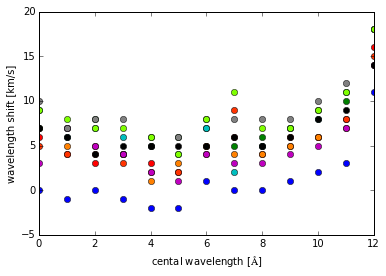

In [8]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_color_cycle(colorlist)
lines = ax.plot(shifts, 'o')
plt.xlabel('cental wavelength [$\AA$]')
plt.ylabel('wavelength shift [km/s]')

# The last two plots are at the lowest wavelength. There is clearly a systematic here. 
# For the purposes of this paper, we only need to make sure that things are consistent, so we will use
# the first ten values.
print shifts[:-2,:].mean(axis=0)
print np.std(shifts[:,:], axis=0)

The wavelength scale in \emph{HST}/COS spectroscopy is usually calibrated with an internal calibration lamp, that flashes on and off during the observation on a part of the detector where it does not overlap with the science data. According to the COS instrument handbook, this calibration is good to about 15~km~s$^{-1}$ for the medium resolution gratings we used\footnote{http://www.stsci.edu/hst/cos/documents/handbooks/current/ch05.COS_Spectroscopy02.html}. We improve this wavelength calibration using features in the spectra. The FUV data contains hundreds of $H_2$ emission lines, which are observed to show a consistent velocity shift of $13.55\pm0.10$~km~s$^{-1}$ in \emph{HST}/STIS \citep{2002ApJ...572..310H}. In turn, this shift is fully consistent with the radial velocity of TW~Hya \citep{2002ApJ...572..310H}. We cross-correlate each of our ten FUV spectra with the STIS/E140M spectrum used in \cite{2002ApJ...572..310H} (\dataset{ADS/sa.HST\#o59d01030}) in spectral regions that are dominated by $H_2$ lines (1385 to 1415, 1430 to 1458, 1458 to 1510, 1510 to 1530, 1585 to 1605, 1605 to 1625, and 1654 to 1660 \AA{}) and measure the relative velocity shift. The maximal difference between two spectra is $<8$~km~s$^{-1}$, indicating a better than expected wavelength stability for \emph{HST}/COS \citep[similar to the findings of][]{2013ApJS..207....1A}; for each individual spectrum, the standard deviation between the eight spectral regions is $<4$~km~s$^{-1}$. We shift each spectrum such that the $H_2$ lines are at rest. In the FUV channel, the accuracy is thus limited by the \emph{HST}/STIS calibration from \citet{2002ApJ...572..310H} to $3$~km~s$^{-1}$, assuming that the $H_2$ lines are still at rest with respect to TW~Hya. This is a resonable assumption, since they orignate in the upper layer of the accretion disk and we see this disk face-on.

In [9]:
stisdata = Table.read(datastis+'o59d01020_x1d.fits', hdu=1)
# I have no idea why this is read in as masked, since no value is actually masked?
#assert np.all([0 == data[c].mask.sum() for c in data.colnames])
stisdata = stisdata.filled()

# None means start 1 ang from the edges
# These ranges are selected by hand (see above) to avoid ion emission lines
xcorrlimits = [
(3, [2790.*u.AA, 2793.*u.AA]),
(6, [2667.*u.AA, 2680.*u.AA]),
(9, [2575.*u.AA, 2580.*u.AA]),
(9, [None, 2570.*u.AA])
]

shiftsnuv = np.zeros((len(xcorrlimits), len(nuv))) * u.km/u.second
for i, xcorrlim in enumerate(xcorrlimits):
    shiftsnuv[i,:] = xcorr_order(xcorrlim[0], stisdata, nuv, xcorrlim[1])

[ 11.5   13.25   9.    -1.25  16.5   14.25  10.5   15.75   8.25  17.5 ] km / s
[ 11.5  13.5   9.5  -0.5  19.   14.   10.   16.   14.   17.5] km / s
[  4.03112887   3.03108891   4.94974747   4.43705984   4.33012702
   3.83242743   2.87228132   2.86138079  13.00720954   1.5       ] km / s


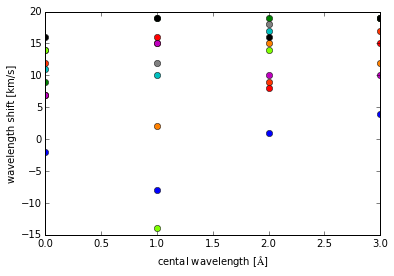

In [10]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_color_cycle(colorlist)
lines = ax.plot(shiftsnuv, 'o')
plt.xlabel('cental wavelength [$\AA$]')
plt.ylabel('wavelength shift [km/s]')

# The last two plots are at the lowest wavelength. There is clearly a systematic here. 
# For the purposes of this paper, we only need to make sure that things are consistent, so we will use
# the first twn values.
print shiftsnuv.mean(axis=0)
print np.median(shiftsnuv, axis=0)
print np.std(shiftsnuv, axis=0)

In [11]:
shifts.value

array([[  6.,   5.,   7.,   0.,   7.,   9.,   3.,  10.,   9.,   7.],
       [  4.,   4.,   5.,  -1.,   7.,   6.,   7.,   7.,   8.,   6.],
       [  3.,   4.,   5.,   0.,   8.,   7.,   5.,   8.,   7.,   4.],
       [  4.,   3.,   4.,  -1.,   4.,   6.,   4.,   8.,   7.,   5.],
       [  3.,   2.,   1.,  -2.,   6.,   5.,   2.,   5.,   6.,   5.],
       [  2.,   2.,   3.,  -2.,   6.,   4.,   1.,   6.,   4.,   5.],
       [  4.,   5.,   5.,   1.,   7.,   7.,   4.,   8.,   8.,   5.],
       [  6.,   9.,   4.,   0.,   5.,   2.,   3.,   8.,  11.,   6.],
       [  4.,   5.,   4.,   0.,   6.,   5.,   3.,   8.,   7.,   5.],
       [  6.,   5.,   5.,   1.,   7.,   7.,   4.,   8.,   7.,   6.],
       [  6.,   6.,   6.,   2.,   9.,   8.,   5.,  10.,   9.,   8.],
       [  8.,   8.,   7.,   3.,  10.,  11.,   7.,  12.,  11.,   9.],
       [ 16.,  15.,  14.,  11.,  18.,  18.,  14.,  18.,  18.,  14.]])

In [12]:
def lineshift(spec, region, **kwargs):
    # normalize flux to about one, otherwise fit won't work
    line = spec.slice_disp(region)
    g_init = LineAbsModel(amplitude=np.mean(line.flux.value)*3*1e12,
                   stddev=.8, const=.1,
                   amplitude2=np.mean(line.flux.value)*2.5*1e12, stddev2=0.05, **kwargs)
    f2 = fitting.SLSQPLSQFitter()
    g = f2(g_init, line.disp.value, line.flux.value*1e12)  # Is there a way to ignore stdout?
    print g.mean, g.mean2, g.amplitude, g.amplitude2, g.stddev, g.stddev2
    return g.mean, g.mean2

MgII2796shift = np.zeros((len(nuv), 2))
for i, spec in enumerate(nuv):
    MgII2796shift[i,:] = np.array(lineshift(spec, [2793*u.AA,2800*u.AA], 
                                            mean=2796.55, mean2=2796.25)).reshape(-1)
    
MgII2803shift = np.zeros((len(nuv), 2))
for i, spec in enumerate(nuv):
    MgII2803shift[i,:] = np.array(lineshift(spec, [2800*u.AA,2807*u.AA], 
                                            mean=2803.7, mean2=2803.45)).reshape(-1)

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.812910497172
            Iterations: 14
            Function evaluations: 143
            Gradient evaluations: 14
Parameter('mean', value=2796.48857781) Parameter('mean2', value=2796.26888136) Parameter('amplitude', value=1.51009570154) Parameter('amplitude2', value=1.21321190206) Parameter('stddev', value=0.523219863908) Parameter('stddev2', value=0.0709357369518)
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.76292746947
            Iterations: 14
            Function evaluations: 143
            Gradient evaluations: 14
Parameter('mean', value=2796.46812525) Parameter('mean2', value=2796.25420826) Parameter('amplitude', value=1.4910850709) Parameter('amplitude2', value=1.21062342679) Parameter('stddev', value=0.525032331681) Parameter('stddev2', value=0.0694516831657)
Optimization terminated successfully.    (Exit mode 0)
            Current fun

In [13]:
print (MgII2796shift[:,:] * spec.disp.unit).to(u.km/u.s, 
                                               equivalencies=u.doppler_optical(2796.3521*u.AA))

[[ 14.63156847  -8.92173782]
 [ 12.43888217 -10.49481736]
 [ 13.50230124 -10.71303374]
 [ 19.11125311  -0.58771637]
 [ 10.7582237  -12.10063431]
 [ 13.15488166 -12.67203027]
 [ 17.74537111  -7.35522776]
 [  8.96860284 -16.37394385]
 [  8.35896441 -14.13483591]
 [ 21.96783156 -11.27108052]] km / s


In [14]:
print (MgII2803shift[:,:] * spec.disp.unit).to(u.km/u.s, 
                                               equivalencies=u.doppler_optical(2803.5310*u.AA))

[[ 11.06523317  -9.71118199]
 [ 10.33528954 -10.81133373]
 [ 10.40579031 -11.58303701]
 [ 17.39085853  -1.15031247]
 [  9.29471156 -13.15398815]
 [ 11.00812415 -13.05782628]
 [ 10.87025246  -8.27608125]
 [  5.55401768 -17.02413071]
 [  4.09852857 -14.47111822]
 [ 13.99120313 -12.09864893]] km / s


Unfortunately, the COS/NUV spectra cover a much smaller wavelength range and there are much fewer $H_2$ lines. We fit the sharp absorption line within the wider \ion{Mg}{2} emission lines at 2796.3521~\AA{} and 2803.5310~\AA{}. We assume that the absorption is due to interstellar material at rest and we shift the NUV spectra to the rest frame of TW~Hya using the values found here. The difference between the fitted values for both lines in the \ion{Mg}{2} doublet is less than 1~km~s$^{-1}$; the absolute uncertaity is about 4~km~s$^{-1}$, mostly due to the uncertainty in the radial velocity of TW~Hya. 

We also correlate our NUV data with the STIS/E230M spectrum \dataset{ADS/sa.HST\#o59d01020}, but we find a larger scatter up to 20~km~s$^{-1}$ between the different regions used for cross-correlation within a single spectrum. The difference between the values found from the \ion{Mg}{2} absorption lines and this method is also of the order 10-20~km~s$^{-1}$, presumably because there are only very few features in the noisy spectra used for cross-correlation.

In [15]:
# Units are lost in the fitting, so add km/s here again
#for spec, rv in zip(fuv, shifts.mean(axis=0)):
#    spec.shift_rv(rv * u.km / u.s)
    
NUVshifts = np.zeros_like(MgII2796shift)
NUVshifts[:, 0] = (MgII2796shift[:,1] * spec.disp.unit).to(u.km/u.s, 
                                               equivalencies=u.doppler_optical(2796.3521*u.AA))
NUVshifts[:, 1] = (MgII2803shift[:,1] * spec.disp.unit).to(u.km/u.s, 
                                               equivalencies=u.doppler_optical(2803.5310*u.AA))

In [16]:
NUVshifts.mean(axis=1), np.median(shiftsnuv, axis=0)-13.55*u.km/u.s

(array([ -9.3164599 , -10.65307554, -11.14803538,  -0.86901442,
        -12.62731123, -12.86492828,  -7.81565451, -16.69903728,
        -14.30297707, -11.68486472]),
 <Quantity [ -2.05, -0.05, -4.05,-14.05,  5.45,  0.45, -3.55,  2.45,  0.45,
              3.95] km / s>)

In [17]:
# Do the actual shift of the data
dv = shifts[:-2,:].mean(axis=0)

for i in range(10):
    fuv[i].shift_rv(dv[i] - 13.55*u.km/u.s)

(0, 0.5)

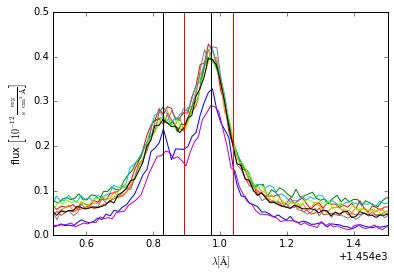

In [18]:
# plot a line after the shift to check that I did not screw up the signs.
plot_spectra(fuv)
plt.xlim([1454.5,1455.5])
# observed wavelength in Herczeg et al 2002
plt.plot([1454.892, 1454.892], [0,1], 'r')
plt.plot([1455.038, 1455.038], [0,1], 'r')
# Real wavelengths in Abgrall
plt.plot([1454.971, 1454.971], [0,1],'k')
plt.plot([1454.829, 1454.829], [0,1], 'k')


plt.ylim([0,.5])


In [19]:
# Shift the NUV data.
dv = NUVshifts.mean(axis=1)*u.km/u.s

# use - dv instead of +dv here, because the Mg II fit gives the sign the other way around compared to xcorr
for i in range(10):
    nuv[i].shift_rv(-dv[i] - 13.55*u.km/u.s)

(2795, 2798)

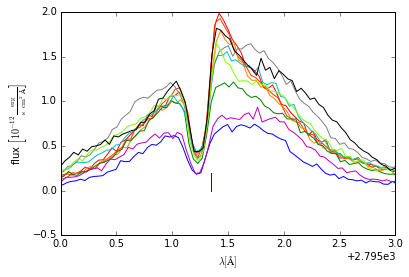

In [20]:
plot_spectra(nuv)
plt.plot([2796.3521, 2796.3521],[0,.2]) # Line position from CHIANTI, which is 13.55 km/s from TW Hya at rest
plt.xlim([2795,2798])

### SMARTS

Photometric monitoring was performed with the ANDICAM instrument \citep{2003SPIE.4841..827D} on the SMARTS/CTIO 1.3m telescope operated by the SMARTS consortium. Exposures were taken nightly in queue mode. ANDICAM uses a Fairchild 447 2048x2048 CCD with 15-micron pixels for observations in KPNO-recipe Johnson-Kron-Cousins $BVRI$ filters. The field-of-view is about 6\arcsec{} on each side. TW~Hya was roughly centered in this field. $YJHK$ images are taken with a Rockwell 1024x1024 HgCdTe ``Hawaii'' Array with 18-micron pixels. The FOV is about 2.4\arcsec{} on the side. The $JHK$ filters are standard CIT/CTIO filters and the $Y$ filter is a 1.05-micron central bandpass filter. The ANDICAM pipeline subtracts the overscan bias and a zero frame before flatfielding the CCD images. Three exposures are taken in $BVRI$ each, with exposure times of 20, 8, 4 and 2~s, respectively. The IR images are corrected for bad pixels, cosmic-ray rejected and the six dither positions (exposure time 4~s each) are co-added. We perform aperture photometry on the resulting CCD and IR images, using an aperture radius of four times the FWHM of the PSF. In each case, the four brightest stars in the field are used for relative photometry. We discard the $K$ and $Y$ data due to the low signal of the comparison stars.

The pipeline processed data for this observation is available at \textbf{put in dataverse, where put my lightvurve? Dataverse or electronic table in article?}

In [21]:
#Merge FUV and NUV of each observation into one array for easier plotting
cos = []
for f, n in zip(fuv, nuv):
    disp = np.hstack([f.disp.value, n.disp.value]) * f.disp.unit
    cos.append(spectrum.coadd.coadd_simple([f,n], dispersion=disp, bounds_error=False))
    cos[-1].meta = n.meta

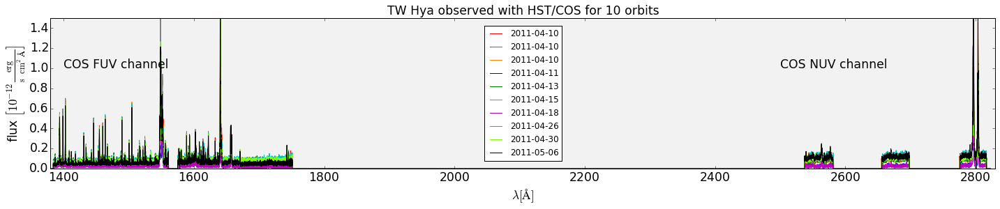

In [22]:
plt.figure(figsize=(20,4))
plot_spectra(cos)
plt.ylim([0,1.5])
plt.xlim([1380, 2830])
plt.legend(loc='center')
fig = plt.gcf()
ax = plt.gca()
ax.set_axis_bgcolor('0.95')
ax.text(2500,1.0, 'COS NUV channel', fontsize='xx-large')
ax.text(1400,1.0, 'COS FUV channel', fontsize='xx-large')
plt.setp(ax.get_xticklabels(), fontsize='xx-large')
ax.set_xlabel(ax.get_xlabel(), fontsize='xx-large')
plt.setp(ax.get_yticklabels(), fontsize='xx-large')
ax.set_ylabel(ax.get_ylabel(), fontsize='xx-large')
#ann = ax.annotate('variable\ncontinuum', xy=(1700,.1),  xycoords='data',
#                xytext=(1800, 0.6), textcoords='data',
#                size=20, va="center",
#                bbox=dict(boxstyle="round", fc=(1.0, 0.7, 0.7), ec="none"),
#                arrowprops=dict(arrowstyle="wedge,tail_width=1.",
#                                fc=(1.0, 0.7, 0.7), ec="none",
#                                patchA=None,
#                                patchB=None,
#                                relpos=(0.2, 0.5),
#                                )
#                )
plt.title('TW Hya observed with HST/COS for 10 orbits', fontsize='xx-large')
fig.subplots_adjust(left=0.05, right=0.99, bottom=0.15)

#plt.savefig(posterdir + 'longspec.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

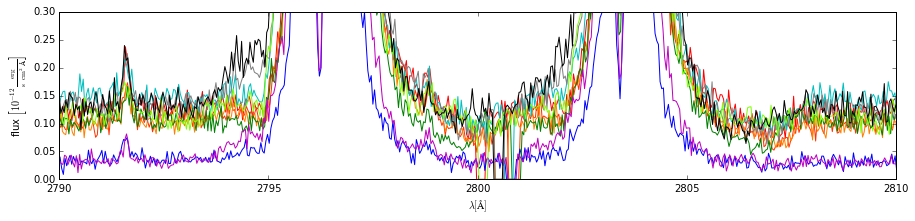

In [23]:
fig = plt.figure(figsize = (15,3))
fig = plot_spectra(nuv)
temp = plt.xlim([2530, 2590])
temp = plt.xlim([2650, 2700])
temp = plt.xlim([2790, 2810])
temp = plt.ylim([0,3e-1])

#### Fit individual lines

Use Gaussfits of lines (H_2 or ISM - Mg II). The center of the line is more accurate than 1 pixel.
Here is a list of lines to try:

- CHIANTI: Mg II is multiplets with strong lines at 2796.3521 and 2803.5310 (Other lines of multiplet visible. Dens or temp sensitive?)
- Bunch of Fe II lines with tentative identifications:
    - Fe II 2563.3091
    - Fe II 2564.2490
    - ????? 2576.8
    - Fe II 2578.7000
    - Fe II 2539.7620
- FUV atomic lines. Often with ISM abs -> absolute wavecal possible
    - N I 1492.6281
    - Si II 1526.7090 - ISM abs
    - Si II 1533.4320
    - Mg II 2796.3521 and 2803.5310

- What are the other NUV lines, e.g.
    - 2670 ?
    - 2791.6 - probably Mg II fomr same multiplet. Is that a dens/ temp diagnostic?

### Continuum flux and shape

In [24]:
def clip_expand(data, n=5):
    '''mask at least n values around each masked value
    
    Use this to prevent the wings of the H_2 emission lines to contribute'''
    mask = np.array(data.mask, dtype=np.float)
    kernel = np.ones(2*n)
    data.mask = np.convolve(mask, kernel, mode='same') > 0
    return data

(0, 2e-13)

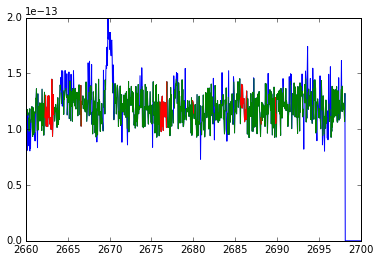

In [25]:
from astropy.stats import sigma_clip
line=cos[9].slice_disp([2660*u.AA, 2700*u.AA])
#line=cos[9].slice_disp([1500*u.AA, 1630*u.AA])
plt.plot(line.disp.value, line.flux.value)
fclip = sigma_clip(line.flux.value, iters=3, sigma=2)
plt.plot(line.disp.value, fclip)
plt.plot(line.disp.value, clip_expand(fclip,n=20))

plt.ylim([0,2e-13])

In [26]:
cliprange = np.array([[1400,1450], [1450,1500], [1500, 1550], [1580,1630], [1630,1680],
                      [1680, 1730], 
                      [2560, 2580], [2650, 2700], [2777, 2792]]) * u.Angstrom

In [27]:
cont_flux = np.zeros((10,9))
for i, spec in enumerate(cos):
    for j in range(len(cliprange)):
        line = spec.slice_disp(cliprange[j,:])
        clipped = sigma_clip(line.flux.value, iters=None)
        cont_flux[i,j] = np.ma.median(clip_expand(clipped, n=20))
        #cont_flux[i,j] = np.percentile(clip_expand(clipped, n=20), 5)

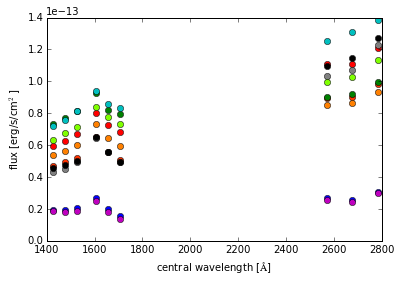

In [28]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_color_cycle(colorlist)
lines = ax.plot(cliprange.mean(axis=1).value, cont_flux.T, 'o')
plt.xlabel('central wavelength [$\AA$]')
plt.ylabel('flux [erg/s/cm$^2$]')

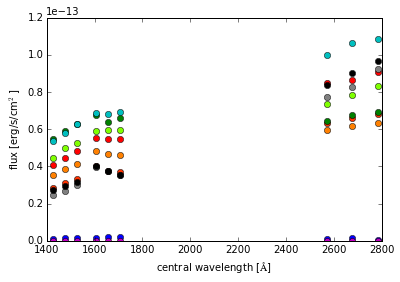

In [29]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_color_cycle(colorlist)
lines = ax.plot(cliprange.mean(axis=1).value, cont_flux.T-cont_flux.T[:,6][:,None], 'o')
plt.xlabel('central wavelength [$\AA$]')
plt.ylabel('flux [erg/s/cm$^2$]')

In [30]:
from scipy.optimize import curve_fit
import astropy.constants as const

def planck(T, wave):
    '''Planck function  
    Parameters
    ----------
    Input units are hardcoded, because scipy's curvefit chops them off
    
    Returns
    -------
    spectral radiance per unit projected area of emitting surface, per unit solid angle,
    per Ang
    '''
    wave = wave * u.AA
    T = T * u.K
    factor = 2.*const.h*const.c**2. / wave**5.
    expfactor = np.exp(const.h*const.c / (wave*const.k_B*T)).decompose() - 1. 
    return factor.to(u.erg/u.AA/u.second/u.cm**2) / expfactor

def fitfunc(wave, amp, T):
    # 4 pi to go from per unit solit angle to full sphere
    return amp * 4 * np.pi* planck(T, wave).value

fitres= np.zeros((cont_flux.shape[0],2))
for i in range(len(cos)):
    # subtract the lowest flux as a template of non-accreting state
    a,b = curve_fit(fitfunc, cliprange.mean(axis=1).value, cont_flux[i,:] - cont_flux[6,:], p0=[1e-21, 2e5])
    fitres[i,:] = a

/melkor/d1/guenther/soft/anaconda/lib/python2.7/site-packages/scipy/optimize/minpack.py:604: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


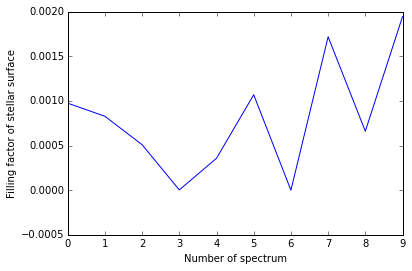

In [31]:
# Assuming R_* = 0.7
fitres[:, 0] = (fitres[:,0] * (57*u.pc)**2 / (0.7*const.R_sun)**2).decompose()
plt.plot(fitres[:,0])
plt.ylabel('Filling factor of stellar surface')
plt.xlabel('Number of spectrum')

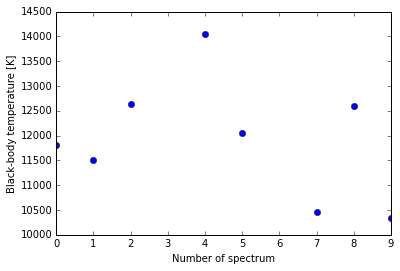

In [32]:
# Set those to nan where the filling factor = 0
ind = fitres[:,0] < 0.0001

fitres[:,1][ind] = np.nan
plt.plot(fitres[:,1],'o')
plt.ylabel('Black-body temperature [K]')
plt.xlabel('Number of spectrum')

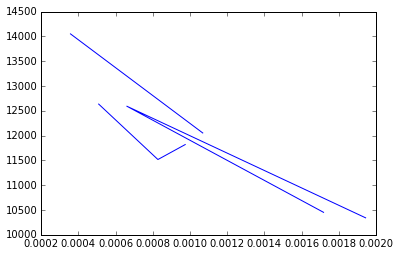

In [33]:
plt.plot(fitres[:,0], fitres[:,1])

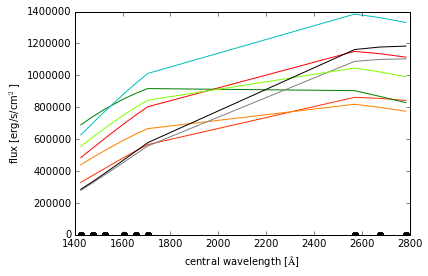

In [34]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_color_cycle(colorlist)
lines = ax.plot(cliprange.mean(axis=1).value, cont_flux.T-cont_flux.T[:,6][:,None], 'o')
plt.xlabel('central wavelength [$\AA$]')
plt.ylabel('flux [erg/s/cm$^2$]')
ax.set_color_cycle(colorlist)
for i in range(10):
    ax.plot(cliprange.mean(axis=1).value, 
            fitfunc(cliprange.mean(axis=1).value, fitres[i,0], fitres[i,1]))


The plot above shows black-body fits to the "continuum" measurements that are performed using sigma clipping. All temperatures are around 12000 K, which indicates that my numbers are not totally bogus. However, the fits are not particualrly good. That might just indicate that there are other continuum features in the data (see Kevin France's work) or that I did not subtract the emission lines well enough yet.

The fit is much better is I subtract a base value (e.g. the continuum in Obs 6). There are still some systematics (cp. the middle group of three points in the plot above). Still I find an anticorrelation between area and temperature. I doubt that that's physicla. It might just mean that those parameters are strongly correlated in the fit and I don't learn much above the "flux".

I think the temperature scale is around 12000 K and the filling factor is around 0.1%, but the fits are not good enough to believe the $\Delta T$ or $\Delta$ amplitude. Not surprisingly, the spectra in the low state have the smallest filling factors, but also relatively high temperatures. It almost seems that more accretion cools down the chromosphere.

**Mal die Bereiche von Kavin France (Christians email) ausprobieren. Das sind Bereiche von dnen wir wissen, dass sie (fast) Linien frei sind. Ich bin mir sicher, dass das nicht viel anders (ich glaube, dass sigma clipping funktioniert), aber kann man ja mal testen.**


### Line fluxes and line shapes

In [35]:
# This is the line list that Christian gave me for comparison
H2progressions = Table.read('../H2lines/H2_model.dat', format='ascii.commented_header', header_start=3)

In [36]:
H2prorg = H2progressions.group_by('codeu')

In [37]:
H2prorg.groups[1][:-10]

angst,cmm1,A*p,codeu,codef
float64,float64,float64,int64,int64
1108.1,90242.0,232000.0,10001,0
1112.5,89888.0,478000.0,10001,2
1161.7,86081.0,1610000.0,10001,100
1166.3,85745.0,3300000.0,10001,102
1217.2,82155.0,5090000.0,10001,200
1222.0,81836.0,10300000.0,10001,202
1274.5,78460.0,9600000.0,10001,300
1279.5,78158.0,19200000.0,10001,302
1333.5,74992.0,12000000.0,10001,400


In [38]:
# Let's see if I can use the Abgrall line list directly. Reduce the risk of errors in the propagation
# of derived files.
# If this is the same, I'll use the routine I already wrote.

data = np.loadtxt(H2.Abgrall93file, skiprows=3, dtype=[('vu','i4'), ('Ju','i4'), ('vl','i4'), ('Jl','i4'),
                                               ('A','f4'), ('wavenumber','f8')])
Abgrall93 = Table(data)
Abgrall93.add_column(Column(name='wave', data=1./Abgrall93['wavenumber'] * 1e8, unit=u.AA))
# Add string columns useful for output to LaTeX table etc.
out = []
for d in data:
    if d['Ju'] - d['Jl'] == -1:
        letter = 'P'
    elif d['Ju'] - d['Jl'] == 1:
        letter = 'R'
    else:
        raise NotImplementedError
        
    code = '{0}({1}) {2}-{3}'.format(letter, d['Jl'], d['vu'], d['vl'])
    out.append(code)
Abgrall93.add_column(Column(name='speccode', data=out))

out = []
for d in data:
    out.append('Ju:{0} vu:{1}'.format(d['Ju'], d['vu']))
Abgrall93.add_column(Column(name='upperlevel', data=out))

In [39]:
Abgrall93 = Abgrall93.group_by('upperlevel')

In [40]:
Abgrall93.groups[Abgrall93.groups.keys['upperlevel'] == 'Ju:1 vu:0'][:-10]

vu,Ju,vl,Jl,A,wavenumber,wave,speccode,upperlevel
,,,,,,Angstrom,,
int32,int32,int32,int32,float32,float64,float64,str11,str11
0,1,0,2,6.211e+06,89888.04,1112.49505496,P(2) 0-0,Ju:1 vu:0
0,1,0,0,3.014e+06,90242.39,1108.12667971,R(0) 0-0,Ju:1 vu:0
0,1,1,2,4.288e+07,85744.57,1166.25460948,P(2) 0-1,Ju:1 vu:0
0,1,1,0,2.098e+07,86081.25,1161.69316779,R(0) 0-1,Ju:1 vu:0
0,1,2,2,1.338e+08,81836.1,1221.95461416,P(2) 0-2,Ju:1 vu:0
0,1,2,0,6.609e+07,82155.46,1217.20455342,R(0) 0-2,Ju:1 vu:0
0,1,3,2,2.495e+08,78157.73,1279.46397624,P(2) 0-3,Ju:1 vu:0
0,1,3,0,1.248e+08,78460.03,1274.53430747,R(0) 0-3,Ju:1 vu:0


At this point I have two options with different pros and cons:

1) BFG: make Spectra for each progression and fit shift, width and norm
   - most correct, takes care of blends etc. 
   - probably numerically unstable because large number of params and low signal bins. Will need to select which progressions to fit (e.g. all the Greg saw)
   - need to exclude absobed lines, but will probably see those in residuals.
   - Sensitive to wavelength cal errors
   - will take care of upper limits automatically, because they are not indivdually calculated.
   - need model for continuum. Either local or global. Since continuum has many bins and lines have few bins, the continuumfit is imporant. Many ways to go wrong with complex continuum. Maybe use piecewise locally constant and fit only regiosn with lines? In that case I'm almost back at option 2.

2) Use summer student's work and use fluxes of already identified lines. 
  - Pro: Don't have to worry about wavelength shift and width when fitting. Those are taken care of already. Can just linear regress to norm for each progression.
  - Con: Might have to ignore some lines because they are blended (although we took care of moderate blends).
  - might be easier to implement.
  - Hard to take care of upper limits.
  
Implement 2 for new and see how far I get.

In [133]:
from H2 import sherpacode
import H2
import H2.sherpacode
reload(H2.sherpacode)

from sherpa import models
from sherpa.data import Data1D
from sherpa.astro import models as astromodels

sys.path.append('/melkor/d1/guenther/soft/python/filili/')
from filili.shmodelshelper import copy_pars

# Make one instance of every type of model that we need
# and set sensible defaults for the numbers.
constbase = models.Const1D('baseconst')
constbase.c0 = 5e-14

linebase = astromodels.Lorentz1D('linebase')
linebase.fwhm = 0.07
linebase.fwhm.min = .04
linebase.fwhm.max = 1.
linebase.ampl.max = 5e-12
linebase.ampl = 2e-13
linebase.ampl.min = 0

abslinebase = linebase.__class__('abslinebase')
copy_pars(linebase, abslinebase)
abslinebase.ampl.min = -2e-12
abslinebase.ampl = -2e-13
abslinebase.ampl.max = 0

H2linebase = linebase.__class__('H2linebase')

H2linebase.fwhm.min = .04
H2linebase.fwhm.max = 0.09
H2linebase.ampl.max = 1e-12
H2linebase.ampl = 2e-13
H2linebase.ampl.min = 0
H2linebase.fwhm.val = 0.05681
H2linebase.fwhm.frozen = True

In [410]:
def gabrielcsv2dict(gabtable):
    '''Convert Gabriels csv tables with prelininary fits results into nested dicts and lists.
    
    During this time as a summer intern, Gabriel performed preliminary fits of the emission lines
    in the COS spectra. In particular, he visually compared the existing STIS data with our COS observations
    and used that as guidance to decide where we can split the spectra into small regions with just a handful of
    lines which can be fit independently, to improve the speed and the numerical stability of the fits.
    He then examined the fits by hand, checking for fit artifacts
    '''
    gg = gabtable.group_by('Region')
    regions = OrderedDict()
    for g in gg.groups:
        H2linelist = []
        linelist = []
        abslinelist = []
        for l in g:
            if l['line'].startswith('H2'):
                safename = re.sub('[^0-9a-zA-Z]', '_', l['line'])
                H2linelist.append({'name': safename, 'pos.val': l['wave_in']})
            elif l['line'].startswith('?ab'):
                safename = 'abs' + l['line'].replace('.', '_')
                abslinelist.append({'name': safename, 'pos.val': l['wave_in']})
            else:
                safename = 'em' + l['line'].replace('.', '_')
                linelist.append({'name': safename, 'pos.val': l['wave_in']})
            
        fmodellist = [[{'c0.val': g['const1d'][0]}]]
        basemodels = [constbase]
        if H2linelist:
            fmodellist.append(H2linelist)
            basemodels.append(H2linebase)
        if linelist:
            fmodellist.append(linelist)
            basemodels.append(linebase)
        if abslinelist:
            fmodellist.append(abslinelist)
            basemodels.append(abslinebase)
        
        regions[g['Region'][0]] = {'range': [g['start'][0], g['stop'][0]],
                'fmodellist': fmodellist, 'basemodels': basemodels}
    return regions
                     
gabregion = gabrielcsv2dict(gabtabsmaster)

In [278]:
reload(H2)
Abgraldict = H2.read_Abgrall93()

In [438]:
import filili.low_fit

sys.path.append('/melkor/d1/guenther/soft/python/COSlsf/')
from COSlsf import empG160M, tabNUV


class COSModelMaker(filili.low_fit.ModelMaker):
    def finalize_model(self, modellist):
        model = super(COSModelMaker, self).finalize_model(modellist)
        # find which sublist has the H2 lines.
        for sublist in modellist:
            if "H2" in sublist[0].name:
                for l in sublist:
                    # Set to Abgrall line list + TW Hya stellar velocity
                    code = l.name.split('_')
                    wave = Abgraldict['{2}-{3} {0}({1})'.format(code[1], code[2], code[4], code[5])]
                    # Shift for TW Hya rest wavelength
                    wave = wave * (1. - 13.55 / 3e5)
                
                    l.pos.val = wave
                    l.pos.max = wave + 0.05
                    l.pos.min = wave - 0.05
                
                # freeze difference
                filili.low_fit.constant_difference(sublist, 'pos')
                
            
            # look at some line that has a position to decide if this FUV or NUV
            if hasattr(sublist[0], 'pos'):
                samplewave = sublist[0].pos.val

        if samplewave < 2000:
            return empG160M(model)
        else: 
            return tabNUV(model)

In [439]:
from sherpa.data import Data1D
import filili
reload(filili)
import filili.shmodelshelper
reload(filili.shmodelshelper)
import filili.low_fit
reload(filili.low_fit)
modelmaker = COSModelMaker()
fitter = filili.low_fit.Fitter()
from sherpa import optmethods
#fitter.fit_settings['method'] = optmethods.MonCar()
fitter.fit_settings['method'].config['epsfcn'] = 2.2e-16


In [440]:
# While many of the fits work really well, there are cases where the fit "jumps out" of the solution we are 
# looking for, e.g. an emission line becomes to wide that it adds to the continuum instead of fitting
# a weak emission line we care for.
# Here, I have some code to interactively modify the fit parameters for a specific region. My goal is to define starting
# conditions for the fit that ensure that each model component has the same meaning for each epoch,
# e.g. prevent lines from shifting into other features to the left or right.

gabmaster = Table.read('../H2lines/master.csv', format='ascii.csv')
gabregion = gabrielcsv2dict(gabmaster)

# Add constraints to the dicts. For batch processing, I would probably edit the json/YAML in a test file,
# but for debugging this is fine.

# Note sure this feature is physical, but the continuum on the left and right side of the line differ.
# Fitting a line here works.
gabregion['6']['fmodellist'][2][0]['pos.frozen'] = True

# region 7: FWHM fluxtuates widely, most likely it's just not well constrained.
# Might profit from fitting all profiles jointly with coupled FWHM.
# However, no H2 in region 7 and lines are unidentified -> low priority for now

gabregion['10']['fmodellist'][2][0]['fwhm.frozen'] = True

# region 11: width of abs feature varies. Feature moves. No good start value for all fits.
# -> refit manually later.

gabregion['12']['fmodellist'][2][0]['fwhm.frozen'] = True

# reg 14 - > revisit, do not use P (18) 3-4
gabregion['14']['fmodellist'][2][0]['fwhm.frozen'] = True
gabregion['14']['fmodellist'][2][1]['fwhm.frozen'] = True

gabregion['16']['fmodellist'][2][0]['pos.val'] = 1429.95
gabregion['16']['fmodellist'][2][1]['pos.val'] = 1430.15
gabregion['16']['fmodellist'][2][0]['pos.max'] = gabregion['16']['fmodellist'][2][0]['pos.val'] + 0.05
gabregion['16']['fmodellist'][2][0]['pos.min'] = gabregion['16']['fmodellist'][2][0]['pos.val'] - 0.05
gabregion['16']['fmodellist'][2][1]['pos.max'] = gabregion['16']['fmodellist'][2][1]['pos.val'] + 0.05
gabregion['16']['fmodellist'][2][1]['pos.min'] = gabregion['16']['fmodellist'][2][1]['pos.val'] - 0.05

gabregion['18']['fmodellist'][1][0]['fwhm.max'] = 0.1
gabregion['18']['fmodellist'][1][1]['fwhm.max'] = 0.1
gabregion['18']['fmodellist'][1][0]['pos.val'] = 1432.6
gabregion['18']['fmodellist'][1][0]['pos.max'] = gabregion['18']['fmodellist'][1][0]['pos.val'] + 0.1
gabregion['18']['fmodellist'][1][0]['pos.min'] = gabregion['18']['fmodellist'][1][0]['pos.val'] - 0.1

# region 20b: Variable, but no H2 -> low priority

gabregion['38']['fmodellist'][2][2]['fwhm.frozen'] = True

# region 46: C I line is crazy. Don't trust P(8) 4-8, but P(11) 1-6 is OK.
# Look at C I line, because we might learn something there.

gabregion['58']['fmodellist'][2][0]['fwhm.max'] = 0.2
gabregion['58']['fmodellist'][2][0]['fwhm.val'] = 0.1
gabregion['58']['fmodellist'][3][0]['fwhm.max'] = 0.1
gabregion['58']['fmodellist'][3][0]['fwhm.val'] = 0.05
gabregion['58']['fmodellist'][3][0]['pos.val'] = 1526.7

gabregion['86']['fmodellist'][1][0]['pos.val'] = 1600.9

gabregion['89']['fmodellist'][2][0]['fwhm.max'] = 0.1
gabregion['89']['fmodellist'][2][0]['fwhm.val'] = 0.05
gabregion['89']['fmodellist'][2][1]['fwhm.max'] = 0.1
gabregion['89']['fmodellist'][2][1]['fwhm.val'] = 0.05
gabregion['89']['fmodellist'][1][0]['pos.max'] = 1608.5
gabregion['89']['fmodellist'][1][0]['pos.min'] = 1608.35

# TODO: NUV regions. Since they don't have H2, they are low priority for now.

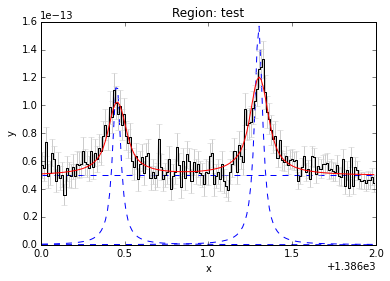

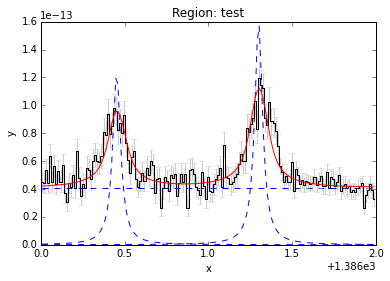

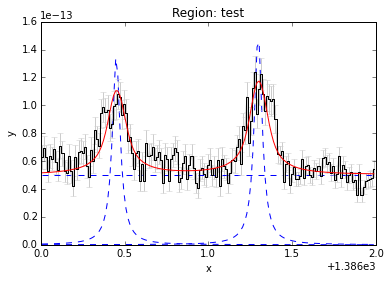

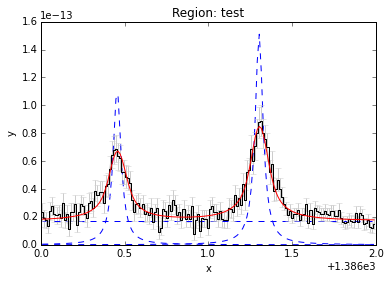

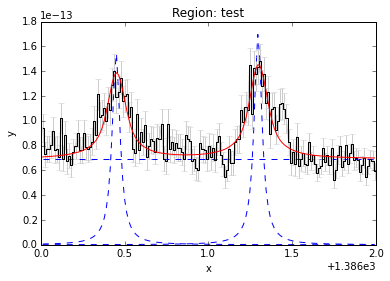

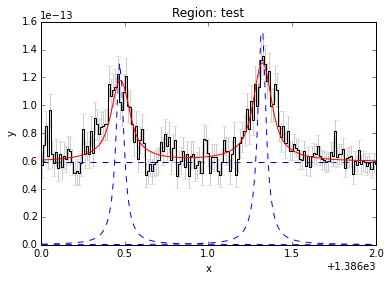

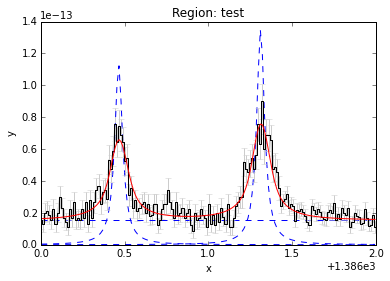

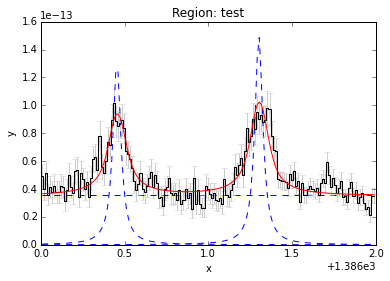

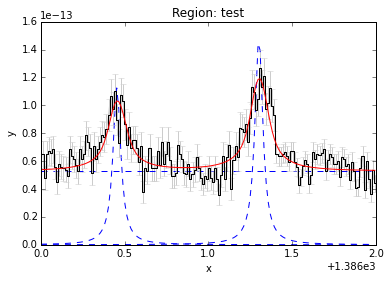

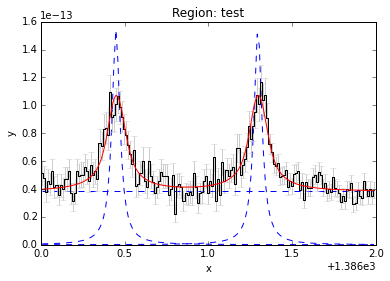

In [441]:
# Code for debugging individual regions in the list

selectregion = OrderedDict(test=gabregion['1'])
#print selectregion
#selectregion['test']['fmodellist'][2][2]['fwhm.frozen'] = True
#selectregion['test']['fmodellist'][2][0]['fwhm.max'] = 0.1
#selectregion['test']['fmodellist'][2][1]['fwhm.max'] = 0.1
#selectregion['test']['fmodellist'][2][0]['pos.val'] = 1608.15
#selectregion['test']['fmodellist'][2][1]['pos.val'] = 1608.3

# Make a separate reporter for each region
reporters = [filili.low_fit.SherpaReporter(plot_path='/melkor/d1/guenther/projects/TWHya/plots/{0}_'.format(i))
                                           for i in range(10)]

for i, c in enumerate(cos):
    master = filili.low_fit.Master(modelmaker=modelmaker, fitter=fitter, fitreporter=reporters[i], confreporter=reporters[i])
    data = Data1D('cos0', c['WAVELENGTH'], c['FLUX'], c['ERROR'])
    master.loop_regions(data, selectregion)

Mache summary von reporters in tables: THe next few cells need to be turend into functions, so that I can call and summarize all of them.
Look for fit problems in resulting numbers in addition to my by-eye, e.g. chi*2.

clean up code in this area (maybe move some to edxternal routine in TWEHYA/H2)?

do science!


LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to be binned in pixels.
delta(x) differs from value given in COS IHB.
LSF convolution requires x to 

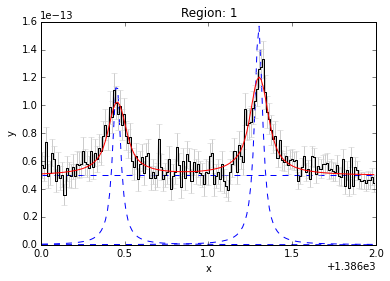

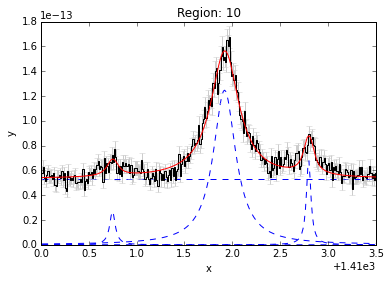

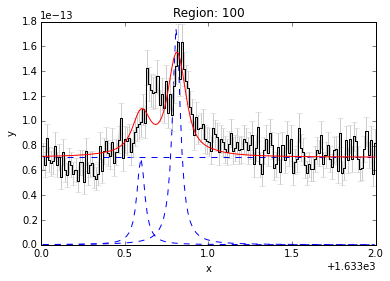

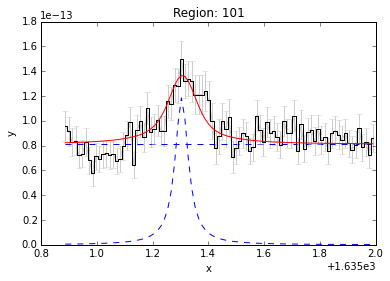

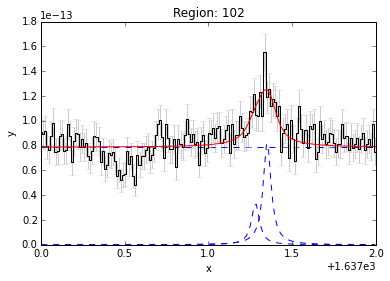

...

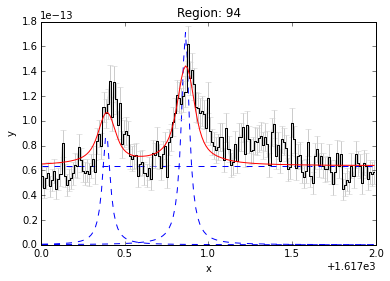

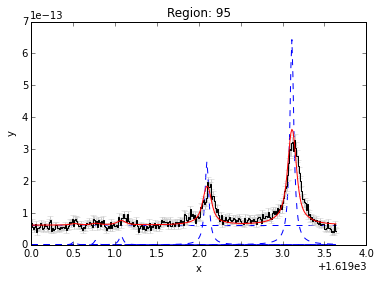

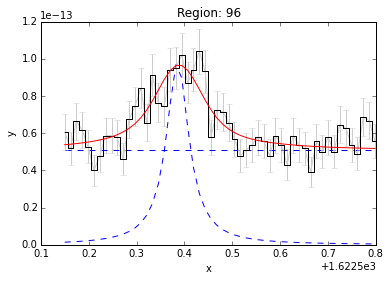

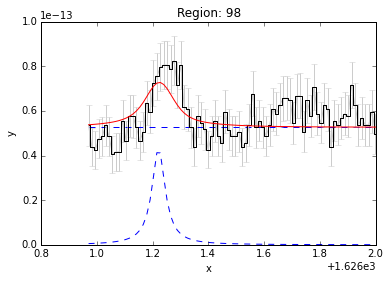

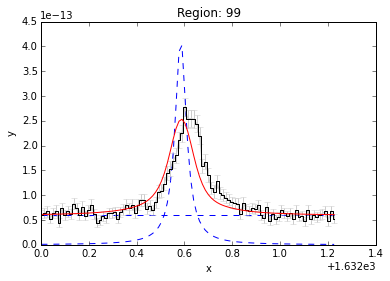

In [442]:
# Make a separate reporter for each region
reporters = [filili.low_fit.SherpaReporter(plot_path='/melkor/d1/guenther/projects/TWHya/plots/{0}_'.format(i))
                                           for i in range(10)]
for i, c in enumerate(cos):
    master = filili.low_fit.Master(modelmaker=modelmaker, fitter=fitter, fitreporter=reporters[i], confreporter=reporters[i])
    data = Data1D('cos0', c['WAVELENGTH'], c['FLUX'], c['ERROR'])
    master.loop_regions(data, gabregion)

In [443]:
# make a second directory, where the images are ordered such that the same wavelength are next to each other
im_to_copy = glob.glob('/melkor/d1/guenther/projects/TWHya/plots/*_*.png')
for i in im_to_copy:
    filename = os.path.basename(i)
    n1, n2 = filename.split('_')
    shutil.copy(i, '/melkor/d1/guenther/projects/TWHya/plots2/{0}_{1}.png'.format(n2.split('.')[0], n1))

In [415]:
def get_model_parts(model):
    if hasattr(model, 'parts'):
        for p in model.parts:
            for parts in get_model_parts(p):
                yield parts
    else:
        yield model
        
list(get_model_parts(master.last_model))

[<Kernel model instance 'empG160M'>,
 <Const1D model instance 'mdl1211'>,
 <Lorentz1D model instance 'H2_P_13__2_9'>]

In [420]:
modelnames = set(n.split('.')[0] for k in reporter.results.keys() for n in reporter.results[k]['parnames'])
parnames = set(n.split('.')[1]  for k in reporter.results.keys() for n in reporter.results[k]['parnames'])
print modelnames, parnames

set(['mdl22', 'mdl23', 'mdl20', 'H2_P_5__4_12', 'mdl26', 'mdl27', 'mdl24', 'mdl25', 'mdl28', 'mdl29', 'H2_P_13__2_7', 'H2_P_13__2_9', 'H2_P_13__2_5', 'H2_P_3__0_7', 'H2_R_12__1_7', 'mdl21', 'em?1495_1', 'mdl52', 'em?1522_28', 'mdl51', 'em?1417_5', 'H2_R_11__2_6', 'H2_R_11__2_5', 'H2_P_14__1_6', 'H2_R_9__1_6', 'H2_R_9__1_7', 'em?1745_29', 'H2_P_16__2_8', 'H2_R_6__1_9', 'em?1473_11', 'H2_R_3__4_9', 'H2_R_3__4_8', 'H2_R_11__2_9', 'H2_R_11__2_8', 'em?1742_78', 'H2_P_5__4_11', 'H2_P_14__3_7', 'H2_P_14__3_6', 'em?1419_25', 'abs?ab1413_8', 'em?1483_07', 'H2_P_8__1_9', 'H2_R_9__2_6', 'mdl19', 'mdl18', 'mdl17', 'mdl16', 'mdl15', 'mdl14', 'H2_R_9__2_9', 'H2_P_8__1_6', 'H2_P_8__1_5', 'mdl10', 'em?1402_828', 'em?1440_87', 'mdl95', 'mdl94', 'mdl93', 'mdl92', 'mdl91', 'mdl90', 'em?1526_7', 'H2_P_1__0_5', 'em?1492_7', 'H2_P_1__0_7', 'H2_P_1__0_6', 'H2_P_1__3_10', 'H2_P_1__3_11', 'em?1423_42', 'H2_P_2__0_5', 'em?1473_95', 'H2_R_12__3_7', 'em?1560_4', 'em?1532_62', 'H2_R_3__4_11', 'H2_R_3__4_12', 'H2_P

In [424]:
# Turn the dict of stuff into a useful table
pnames = []
pvals = []
pmins = []
pmaxes = []
for n, reg in reporter.results.iteritems():
    pnames.extend(reg['parnames'])
    pvals.extend(reg['parvals'])
    pmins.extend(reg['parmins'])
    pmaxes.extend(reg['parmaxes'])

fittab = astropy.table.Table([list(modelnames)], names=['mdlname'], masked=True)
for c in parnames:
    for n in ['val', 'min', 'max']:
        fittab.add_column(MaskedColumn(name='{0}.{1}'.format(c, n), dtype=float, length=len(fittab),
                                       mask=True, format='4.2e'))

In [425]:
for i, n in enumerate(pnames):
    modname = n.split('.')[0]
    pname = n.split('.')[1]
    ind = (fittab['mdlname'] == modname).nonzero()[0][0]
    for v, c in zip([pvals[i], pmins[i], pmaxes[i]], ['val', 'min', 'max']):
        fittab[ind]['{0}.{1}'.format(pname, c)] = v
                    
for n in ['Ju', 'Jl', 'vu', 'vl']:
    fittab.add_column(MaskedColumn(name=n, dtype=np.int, length=len(fittab), mask=True))

for l in fittab:
    if l['mdlname'][0:2]=='H2':
        Ju, Jl, vu, vl = H2.string2numbers('{0} {1}({2}) {4}-{5}'.format(*l['mdlname'].split('_')))
        l['Ju'] = Ju
        l['Jl'] = Jl
        l['vu'] = vu
        l['vl'] = vl

In [426]:
fittab

mdlname,c0.val,c0.min,c0.max,fwhm.val,fwhm.min,fwhm.max,pos.val,pos.min,pos.max,ampl.val,ampl.min,ampl.max,Ju,Jl,vu,vl
str13,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64
mdl22,5.85e-14,-8.39e-16,8.39e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl23,5.93e-14,-8.53e-16,8.53e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl20,6.55e-14,-9.70e-16,9.70e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
H2_P_5__4_12,--,--,--,--,--,--,1.65e+03,-1.33e-02,1.33e-02,4.59e-15,-9.42e-16,9.42e-16,4,5,4,12
mdl26,5.75e-14,-8.04e-16,8.04e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl27,5.94e-14,-7.54e-16,7.54e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl24,5.87e-14,-8.07e-16,8.07e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl25,5.61e-14,-7.69e-16,7.69e-16,--,--,--,--,--,--,--,--,--,--,--,--,--
mdl28,5.11e-14,-9.17e-16,9.17e-16,--,--,--,--,--,--,--,--,--,--,--,--,--


In [427]:
# cannot have missing values in merging, so filter to H2 lines only first.
H2tab = fittab[~fittab['Ju'].mask]
H2tab.remove_columns(['c0.val', 'c0.min', 'c0.max'])
H2tab = astropy.table.join(H2tab, Abgrall93)
H2tab.sort('wave')
H2tab = H2tab.group_by(('Ju','vu'))
H2tab.groups[6]

mdlname,fwhm.val,fwhm.min,fwhm.max,pos.val,pos.min,pos.max,ampl.val,ampl.min,ampl.max,Ju,Jl,vu,vl,A,wavenumber,wave,speccode,upperlevel
,,,,,,,,,,,,,,,,Angstrom,,
str13,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64,float32,float64,float64,str11,str11
H2_R_2__3_7,--,--,--,1.43e+03,-1.38e-03,1.38e-03,4.86e-15,-4.90e-16,4.90e-16,3,2,3,7,7.709e+07,69730.29,1434.09700433,R(2) 3-7,Ju:3 vu:3
H2_P_4__3_7,--,--,--,--,--,--,6.74e-15,-5.43e-16,5.43e-16,3,4,3,7,1.015e+08,69195.46,1445.18151913,P(4) 3-7,Ju:3 vu:3
H2_R_2__3_9,--,--,--,1.54e+03,-1.47e-02,1.47e-02,0.00e+00,-8.16e-15,8.16e-15,3,2,3,9,3.893e+07,64932.05,1540.07150552,R(2) 3-9,Ju:3 vu:3
H2_R_2__3_10,--,--,--,1.59e+03,nan,nan,8.72e-15,nan,nan,3,2,3,10,1.541e+08,62927.05,1589.14171251,R(2) 3-10,Ju:3 vu:3
H2_R_2__3_11,--,--,--,1.63e+03,-5.76e-03,5.76e-03,9.30e-15,-1.04e-15,1.04e-15,3,2,3,11,7.061e+07,61213.72,1633.6206981,R(2) 3-11,Ju:3 vu:3


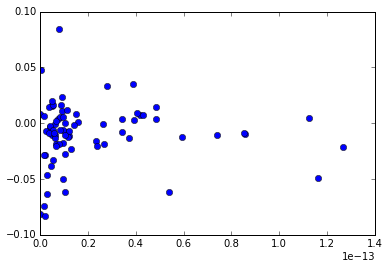

In [428]:
# Values that are high or low indiate that either something wend wrong in the fit or the COS wavelength scale
# needs non-linear corrections.
plt.plot(H2tab['ampl.val'], H2tab['pos.val']-H2tab['wave'], 'bo')

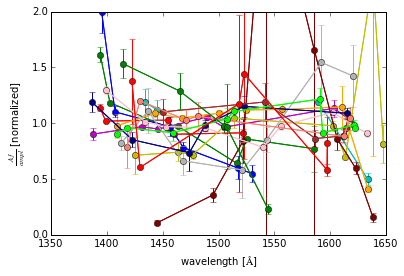

In [131]:
colors=['r', 'g','b','c','m','y','orange','maroon','0.7', 'pink', 'navy', 'brown', 'salmon','lime', 'r', 'g', 'b', 'c', 'k']
i = 0
for g in H2tab.groups[:].groups:
    if len(g) >= 5:
        c = colors[i]
        i += 1
        plotnorm = np.mean(g['A'] * g['wavenumber'] / g['ampl.val'])
#        plotnorm=1
        plt.plot(g['wave'], g['A'] * g['wavenumber'] / g['ampl.val'] / plotnorm, '-o', color=c)

        plt.errorbar(g['wave'], 
                     g['A'] * g['wavenumber'] / g['ampl.val'] / plotnorm, 
                     # Error propagation here! to make that correct
                     g['A'] * g['wavenumber'] / g['ampl.val']**2 * g['ampl.max'] / plotnorm, color=c)
        
plt.ylim(0, 2)
#plt.ylim([0, 2e27])
plt.xlabel(r'wavelength [$\AA$]')
plt.ylabel(r'$\frac{A f}{ampl}$ [normalized]')

In [112]:
g

mdlname,fwhm.val,fwhm.min,fwhm.max,pos.val,pos.min,pos.max,ampl.val,ampl.min,ampl.max,Ju,Jl,vu,vl,A,wavenumber,wave,speccode,upperlevel
,,,,,,,,,,,,,,,,Angstrom,,
str13,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64,float32,float64,float64,str11,str11
H2_P_8__4_7,--,--,--,1.44e+03,-5.74e-03,5.74e-03,2.45e-15,-5.08e-16,5.08e-16,7,8,4,7,6.163e+06,69216.37,1444.74493534,P(8) 4-7,Ju:7 vu:4
H2_P_8__4_8,--,--,--,--,--,--,6.87e-15,-1.18e-15,1.18e-15,7,8,4,8,5.981e+07,66891.95,1494.94819631,P(8) 4-8,Ju:7 vu:4
H2_R_6__4_9,--,--,--,--,--,--,2.74e-15,-6.34e-16,6.34e-16,7,6,4,9,5.712e+07,65702.82,1522.00468717,R(6) 4-9,Ju:7 vu:4
H2_P_8__4_9,--,--,--,1.54e+03,-8.90e-03,8.90e-03,3.43e-16,-7.80e-16,7.80e-16,7,8,4,9,2.953e+07,64833.24,1542.41867289,P(8) 4-9,Ju:7 vu:4
H2_P_8__4_10,--,--,--,1.59e+03,-1.99e-02,1.99e-02,1.92e-15,-3.08e-15,3.08e-15,7,8,4,10,8.23e+07,63063.6,1585.7007846,P(8) 4-10,Ju:7 vu:4
H2_R_6__4_11,--,--,--,1.61e+03,-6.69e-03,6.69e-03,8.35e-15,-9.66e-16,9.66e-16,7,6,4,11,1.882e+08,62255.49,1606.28404017,R(6) 4-11,Ju:7 vu:4
H2_P_8__4_11,--,--,--,1.62e+03,-5.45e-03,5.45e-03,1.19e-14,-1.10e-15,1.10e-15,7,8,4,11,1.885e+08,61617.75,1622.90898321,P(8) 4-11,Ju:7 vu:4
H2_R_6__4_12,--,--,--,--,--,--,7.38e-15,-1.97e-15,1.97e-15,7,6,4,12,3.079e+07,61034.61,1638.41466342,R(6) 4-12,Ju:7 vu:4


In [124]:
# find which regions contains a line:
for reg in gabregion:
    if gabregion[reg]['range'][0] < 1542.4 and gabregion[reg]['range'][1] > 1542.4:
        print reg, gabregion[reg]['range']

65 [1542.0, 1543.5]


In [142]:
# Do I still need this index?
ind_H2 = np.array([n[0:1]=='H2' for n in Gabriel['line']])

In [143]:
for n in ['Ju', 'Jl', 'vu', 'vl']:
    Gabriel.add_column(Column(name=n, dtype=np.int, length=len(Gabriel)))

for l in Gabriel:
    if l['line'][0:2]=='H2':
        Ju, Jl, vu, vl = H2.string2numbers(l['line'])
        l['Ju'] = Ju
        l['Jl'] = Jl
        l['vu'] = vu
        l['vl'] = vl
    else:
        l['Ju'] = -99
        l['Jl'] = -99
        l['vu'] = -99
        l['vl'] = -99       

AttributeError: 'module' object has no attribute 'string2numbers'

In [144]:
Gablines = Gabriel #['line','Ju', 'Jl', 'vu', 'vl', 'fwhm','wave_fit', 'ampl']
# Currently I do an inner join and keep only lines that are in both tables. 
# That gets rid of non-H2 lines in the table of measured H2 lines, but also of undetected theoretical lines.
# I should keep those to see if upper limits are consistent.
# An "outer" join will do that.
glg = astropy.table.join(Gablines, Abgrall93)
glg.sort('wave')
glg = glg.group_by(('Ju','vu'))
glg.groups[6]

IndexError: index 0 is out of bounds for size 0

In [ ]:
import sherpa
import sherpa.astro.models
sys.path.append('/melkor/d1/guenther/soft/python/')
import COSlsf

def make_sherpa_progression_model(group):
    lines = []
    for l in group:
        lnew = sherpa.astro.models.Lorentz1D()
        lnew.fwhm = 0.0568
        lnew.ampl = l['ampl']
        lnew.pos = l['wave_fit']
        lines.append(lnew)
    prog = lines[0]
    for l in lines[1:]:
        prog += l
    return COSlsf.empG160M(prog)

In [ ]:
# match up this with the routine in the next box to use the same colors.
# Then, see if I can emplain the the outlier valiues in the measured amp.
colors=['r', 'g','b','c','m','y','orange','maroon','0.7', 'pink', 'navy', 'brown', 'salmon','lime']

wave = cos[0]['WAVELENGTH']
ind = (wave > 1420.) & (wave < 1680.)

fig = plt.figure(figsize=(20,8))
axspec = fig.add_axes([0.1,0.1,.8,.4])
axprog = fig.add_axes([.1, .5, .8, .4], sharex = axspec)
axspec.set_color_cycle(colors)
axprog.set_color_cycle(colors)

axspec.plot(wave[ind], cos[0]['FLUX'][ind], 'k')

for i in range(21):
    g6 = make_sherpa_progression_model(glg.groups[i])
    axspec.plot(wave[ind], g6(wave[ind]) + np.median(cos[0]['FLUX'][ind]), lw=1)

for i in range(21):
    if len(glg.groups[i]) > 0:
        #print glg.groups[i]['A','wavenumber','ampl']
        axprog.plot(glg.groups[i]['wave'], glg.groups[i]['A'] *glg.groups[i]['wavenumber']/glg.groups[i]['ampl'], '-o')
        
axprog.set_yscale("log")

    
#plt.yscale('log')
axspec.set_xlim([1420,1480])
axspec.set_ylim([0,0.5e-12])

'''Gabriels lines appear slightly shifted with respect to the data, because Gabriel used the OBSERVED wavenlength, 
not the wavelength corrected as above.'''

In [ ]:

for i in range(21):
    if len(glg.groups[i]) > 0:
        #print glg.groups[i]['A','wavenumber','ampl']
        irradval = glg.groups[i]['A'] *glg.groups[i]['wavenumber']/glg.groups[i]['ampl']
        plt.plot(glg.groups[i]['wave'], irradval / np.mean(irradval) , '-o')

In [ ]:

for i in range(21):
    if len(glg.groups[i]) > 0:
        #print glg.groups[i]['A','wavenumber','ampl']
        irradval = glg.groups[i]['A'] *glg.groups[i]['wavenumber']/glg.groups[i]['ampl']
        plt.plot(glg.groups[i]['wave'], irradval / np.mean(irradval) , '-o')
#plt.yscale("log")
#import mpld3
#mpld3.display()
#plt.xlim([1510,1530])

In [ ]:
data = cos[0]
plt.plot()

In [ ]:
glg.groups.keys

In [ ]:
glg.groups[1]

/melkor/d1/guenther/soft/anaconda/lib/python2.7/site-packages/astropy-1.1.dev13397-py2.7-linux-x86_64.egg/astropy/units/quantity.py:830: RuntimeWarning: divide by zero encountered in true_divide
  return super(Quantity, self).__rtruediv__(other)


NameError: name 'posterdir' is not defined

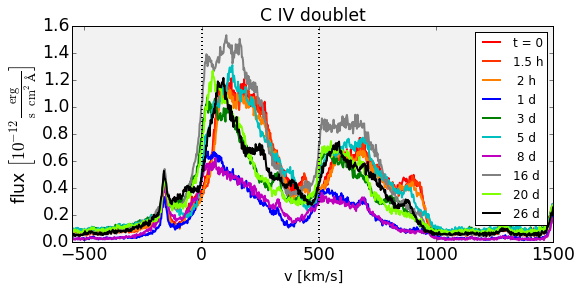

In [145]:
CIV = np.array([1548.19, 1550.775]) * u.Angstrom
def eq(wave):
    return {'equivalencies': u.doppler_optical(wave)}

label = ['t = 0', '1.5 h', ' 2 h', ' 1 d', ' 3 d', ' 5 d', ' 8 d', '16 d', '20 d', '26 d']

def plot_doublet(spectra, waves, title='', bin_up=1):
    fig = plt.figure(figsize=(8,4))
    ax = fig.add_subplot(111, axisbg='0.95')
    for s, c, l in zip(spectra, colorlist, label):
        spec = s.bin_up(bin_up)
        linespec = spec.slice_rv([-550*u.km/u.s, 1500*u.km/u.s], waves[0])
        line = plt.plot(linespec.disp.to(u.km/u.s, **eq(waves[0])).value,
                        linespec.flux.value *1e12, color = c, label=l, lw=2)

    ax.set_xlabel(r'v [km/s]', fontsize='x-large')
    ax.set_ylabel(r'flux $\left[10^{-12} \frac{\rm{erg}}{\rm{s\;cm}^2 \AA}\right]$', fontsize='xx-large')
    ax.plot([0,0], ax.get_ylim(), 'k:', lw=2)
    ax.plot(waves[[1,1]].to(u.km/u.second, **eq(waves[0])).value, ax.get_ylim(), 'k:', lw=2)
    ax.set_xlim([-550, 1500])
    ax.set_ylim([0, 1.6])
    ax.legend()
    ax.tick_params(labelsize='xx-large')
    ax.set_title(title, fontsize='xx-large')
    return fig

fig = plot_doublet(fuv, CIV, 'C IV doublet')
fig.subplots_adjust(right=0.96, bottom=0.15)
#fig.savefig(plotpath+'CIV.png')
plt.savefig(posterdir + 'CIV.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

NameError: name 'posterdir' is not defined

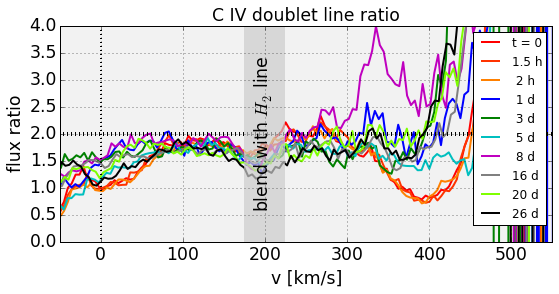

In [146]:
def linerate(spectrum, waves, bin_up=1):
    # Make a copy
    spec = spectrum.bin_up(bin_up)
    contregion = spec.slice_rv([-5000*u.km/u.s,-500*u.km/u.s], waves[0])
    continuum = sigma_clip(contregion.flux.value, iters=1)
    spec[spec.fluxname] -= np.ma.mean(continuum)
    shifted = spec[np.ones((len(spec)), dtype=np.bool)]
    shifted.shift_rv(-waves[1].to(u.km/u.s, **eq(waves[0])))
    return (spec.flux / shifted.interpol(spec.disp, bounds_error=False).flux).decompose()

fig = plt.figure(figsize=(8,4))
ax = fig.add_subplot(111, axisbg='0.95')
for s, c, l in zip(fuv, colorlist, label):
    s = spectrum.spectrum.Spectrum(s, dispersion=s.dispersion)
    s = s.bin_up(2)
    line = plt.plot(s.disp.to(u.km/u.s, **eq(CIV[0])).value, 
                    linerate(s, CIV).value, color = c, label=l, lw=2)
        
ax.set_xlabel(r'v [km/s]', fontsize='xx-large')
ax.set_ylabel(r'flux ratio', fontsize='xx-large')
ax.plot([0,0], ax.get_ylim(), 'k:', lw=2)
ax.plot([-1000,1000], [2,2], 'k:', lw=4)
#ax.set_xlim([-500, 1550])
ax.set_xlim([-50, 550])
ax.set_ylim([0,4])
ax.legend()
ax.tick_params(labelsize='xx-large')
ax.grid()
ax.bar(175,4,50, fc='0.8', ec='none', zorder=2.1,alpha=.7)
ax.text(185, 2, r'blend with $H_2$ line', rotation='vertical', va='center', fontsize='xx-large')
ax.set_title('C IV doublet line ratio', fontsize='xx-large')
fig.subplots_adjust(right=0.98, bottom=0.15)
plt.savefig(posterdir + 'CIV_ratio.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

In [ ]:
MgII = np.array([2796.3521, 2803.5310]) * u.Angstrom

fig = plot_doublet(nuv, MgII, 'Mg II doublet')
fig.subplots_adjust(right=0.97)
plt.savefig(posterdir + 'MgII.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

NameError: name 'MgII' is not defined

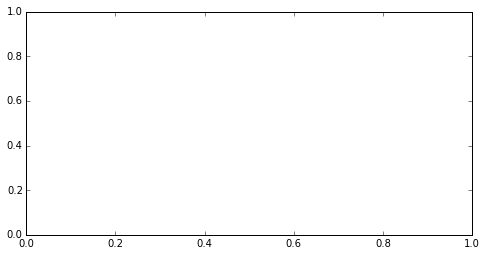

In [147]:
fig = plt.figure(figsize=(8,4))
ax = fig.add_subplot(111)
for s, c, l in zip(nuv, colorlist, label):
    s = spectrum.spectrum.Spectrum(s, dispersion=s.dispersion)
    s = s.bin_up(2)
    line = plt.plot(s.disp.to(u.km/u.s, **eq(MgII[0])).value, 
                    linerate(s, MgII).value, color = c, label=l, lw=2)
        
ax.set_xlabel(r'v [km/s]', fontsize='xx-large')
ax.set_ylabel(r'flux ratio', fontsize='xx-large')
ax.plot([0,0], ax.get_ylim(), 'k:', lw=2)
ax.plot([-1000,1000], [2,2], 'k:', lw=4)
#ax.set_xlim([-500, 1550])
ax.set_xlim([-300, 300])
ax.set_ylim([0,4])
ax.legend()
ax.tick_params(labelsize='xx-large')
ax.grid()
#fig.savefig(plotpath+'optdepth.png')

(0, 0.2)

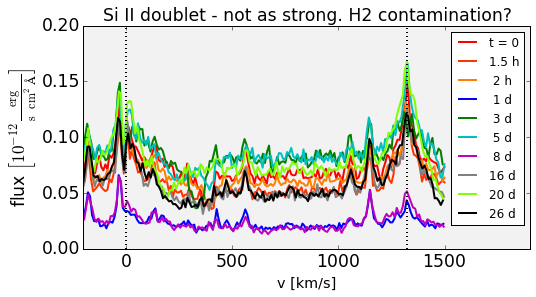

In [148]:
SiII = np.array([1526.707, 1533.431]) * u.Angstrom

fig = plot_doublet(fuv, SiII, 'Si II doublet - not as strong. H2 contamination?', bin_up=4)
ax = fig.axes[0]
ax.set_xlim([-200,1900])
ax.set_ylim([0,0.2])
#fig.savefig(plotpath+'CIV.png')

NameError: name 'posterdir' is not defined

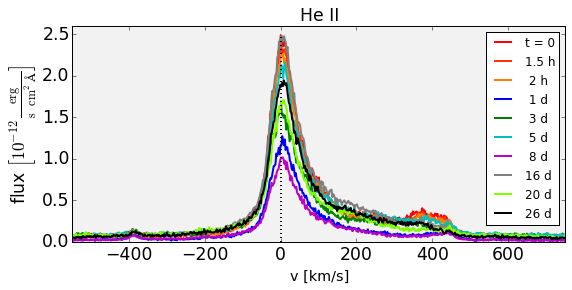

In [149]:
HeII = np.array([1640.4771]) * u.Angstrom

def plot_line(spectra, waves, title, bin_up=1):
    fig = plt.figure(figsize=(8,4))
    ax = fig.add_subplot(111,axisbg='0.95')
    for spec, c, l in zip(spectra, colorlist, label):
        linespec = spec.slice_rv([-550*u.km/u.s, 1500*u.km/u.s], waves[0])
        linespec = linespec.bin_up(bin_up)
        line = ax.plot(linespec.disp.to(u.km/u.s, **eq(waves[0])).value,
                       linespec.flux.value *1e12, color = c, label=l, lw=2)

    ax.set_xlabel(r'v [km/s]', fontsize='x-large')
    ax.set_ylabel(r'flux $\left[10^{-12} \frac{\rm{erg}}{\rm{s\;cm}^2 \AA}\right]$', fontsize='xx-large')
    ax.plot([0,0], ax.get_ylim(), 'k:', lw=2)
    ax.set_xlim([-550, 750])
    ax.set_ylim([0, 2.6])
    ax.legend()
    ax.tick_params(labelsize='xx-large')
    ax.set_title(title, fontsize='xx-large')
    return fig

fig = plot_line(fuv, HeII, 'He II')
fig.subplots_adjust(right=0.98, bottom=0.15)
plt.savefig(posterdir + 'HeII.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

(0, 0.4)

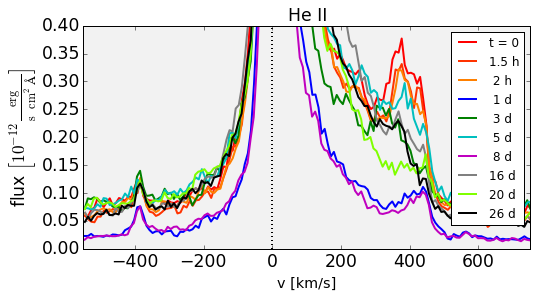

In [150]:
fig = plot_line(fuv, HeII, 'He II', bin_up=4)
fig.axes[0].set_ylim([0, .4])

(0, 1)

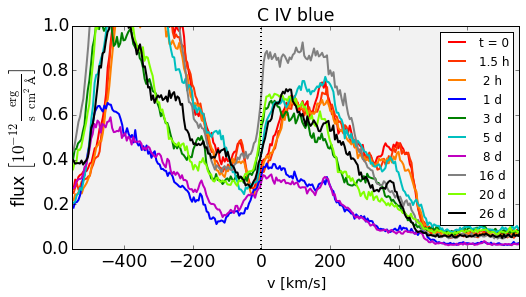

In [151]:
fig = plot_line(fuv, [CIV[1]], 'C IV blue', bin_up=2)
fig.axes[0].set_ylim([0, 1])

(0, 0.6)

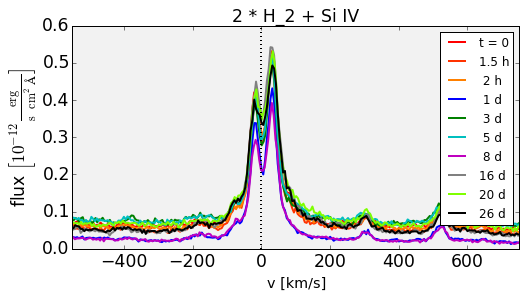

In [152]:
SiIV = np.array([1393.757]) * u.Angstrom
fig = plot_line(fuv, SiIV, '2 * H_2 + Si IV', bin_up=2)
fig.axes[0].set_ylim([0, .6])

(-550, 750)

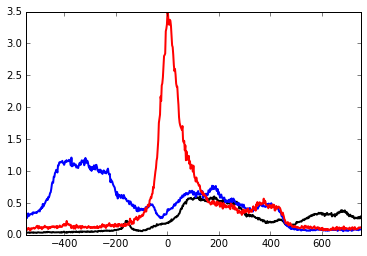

In [153]:
linespec = fuv[0]
line = plt.plot(linespec.disp.to(u.km/u.s, **eq(CIV[0])).value,
                        linespec.flux.value *1e12*0.5, color = 'k', label=l, lw=2)
line = plt.plot(linespec.disp.to(u.km/u.s, **eq(CIV[1])).value,
                        linespec.flux.value *1e12, color = 'b', label=l, lw=2)
line = plt.plot(linespec.disp.to(u.km/u.s, **eq(HeII[0])).value,
                        linespec.flux.value *1e12*1.4, color = 'r', label=l, lw=2)
plt.xlim([-550, 750])

(0, 0.6)

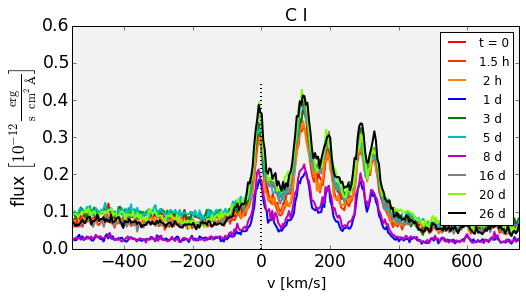

In [154]:
CI = np.array([1656.3]) * u.Angstrom  # Multiplet - only strongest line listed for quicklook
fig = plot_line(fuv, CI, 'C I', bin_up=2)
fig.axes[0].set_ylim([0, .6])

The C I lines look stronger at 26 d than ever. The ratios also change slightly between exposures (e.g. the first 2 vs the later three lines in 1d<->8d), but I am not sure that is statistically significant.

(0, 0.3)

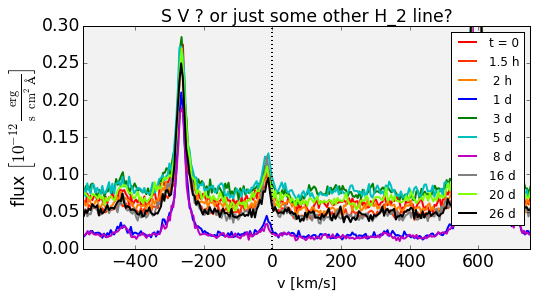

In [155]:
SV = np.array([1501.776]) * u.Angstrom  # Multiplet - only strongest line listed for quicklook
fig = plot_line(fuv, SV, 'S V ? or just some other H_2 line?', bin_up=2)
fig.axes[0].set_ylim([0, .3])

In [156]:
#line = fuv[0].slice_disp([1498*u.AA,1502*u.AA])
#line = fuv[0].slice_rv([-1000*u.km/u.s, 2500*u.km/u.s], HeII[0])
line = nuv[0].slice_rv([-1600*u.km/u.s, 1300*u.km/u.s], MgII[0])
#contregion = spec.slice_rv([-5000*u.km/u.s,-500*u.km/u.s], waves[0])
continuum = sigma_clip(line.flux.value, iters=None, cenfunc=np.ma.median)
#spec[spec.fluxname] -= np.ma.mean(continuum)
continuum.mask.sum()

# something is persistent here and it might not be cigma_clip
# sigma_clip should use ma versions.
# sigma_clip should improve documentation.

NameError: name 'MgII' is not defined

In [157]:
plt.plot(line.disp.value, line.flux.value)
plt.plot(line.disp.value[~continuum.mask], line.flux.value[~continuum.mask])

AttributeError: 'list' object has no attribute 'disp'

In [ ]:
# Now is fully automatic, but that requires either tuning kwargs or have a large section of
# good continuum

def find_continuum(spectrum, iters=None, **kwargs):
    # This works well for isoalted lines. Might want alternative ways for longer spectra.
    # Maybe look for column "continuum" in table?
    # add flux_norm and flux_subtracted as properties?
    continuum = sigma_clip(spectrum.flux.value, iters=iters, **kwargs)
    return np.ma.median(continuum)*spectrum.flux.unit, np.std(continuum)*spectrum.flux.unit

def sum_flux(spectrum):
    return (spectrum.flux[:-1] * np.diff(spectrum.disp)).sum()

def line_flux(spectrum, **kwargs):
    return sum_flux(spectrum) - find_continuum(spectrum, **kwargs)[0] * np.abs(spectrum.disp[0] - spectrum.disp[-1])

def EW(spectrum, **kwargs):
    # does not really make sense for longer spectra...
    return -line_flux(spectrum, **kwargs) / find_continuum(spectrum, **kwargs)[0]

In [ ]:
# Here is the exact same thing, except that line region and background region can be provided as
# separate inputs. I try this out, too, and see how it works and then put one of them into my spectrum
# class.
# I almost don't need the sigma clip here any longer if I hand select continuum regions.
# Other idea is continuum column

def find_continuum(cont_spec, iters=None, **kwargs):
    # This works well for isoalted lines. Might want alternative ways for longer spectra.
    # Maybe look for column "continuum" in table?
    # add flux_norm and flux_subtracted as properties?
    continuum = sigma_clip(cont_spec.flux.value, iters=iters, **kwargs)
    # use filled here, because Quantity doesn ot play nicely with masked array
    return np.ma.median(continuum).filled(np.nan) * cont_spec.flux.unit, np.std(continuum)*cont_spec.flux.unit

def sum_flux(spectrum):
    return (spectrum.flux[:-1] * np.diff(spectrum.disp)).sum()

def line_flux(spectrum, cont_spec, **kwargs):
    return sum_flux(spectrum) - find_continuum(cont_spec, **kwargs)[0] * np.abs(spectrum.disp[0] - spectrum.disp[-1])

def EW(spectrum, cont_spec, **kwargs):
    # does not really make sense for longer spectra...
    return -line_flux(spectrum, cont_spec, **kwargs) / find_continuum(cont_spec, **kwargs)[0]

In [ ]:
(line.flux[:-1] * np.diff(line.disp)).sum()

In [ ]:
find_continuum(line, cenfunc=np.ma.median)

In [ ]:
line_flux(line, line, cenfunc=np.ma.median)

In [ ]:
EW(line, line, cenfunc=np.ma.median)

In [ ]:
ewtab = astropy.table.Table()
fluxtab = astropy.table.Table()
#for n, r in zip(['C IV doublet', 'He II', 'C I multiplet', 'Mg II doublet', 'H_2 P(3) 0-5',
#                 'H_2 P(2) 0-6'],
#                [[1540*u.AA, 1555*u.AA], [1635.*u.AA, 1645.*u.AA], [1650.*u.AA, 1660.*u.AA],
#                 [2790*u.AA, 2810*u.AA], [1402*u.AA, 1404*u.AA],[1459.2*u.AA, 1461*u.AA]]):
for n, r, c in zip(['C IV doublet', 'He II', 'C I multiplet', 'Mg II doublet', 'H$_2$ P(3) 0-5',
                 'H_2 P(2) 0-6'],
                  [[1545.5*u.AA, 1554*u.AA], [1639.*u.AA, 1644.*u.AA], [1655.*u.AA, 1660.*u.AA],
                   [2793*u.AA, 2807*u.AA], [1402*u.AA, 1404*u.AA],[1459.5*u.AA, 1461*u.AA]],
                  [[1540*u.AA, 1546*u.AA], [1635.*u.AA, 1639.*u.AA], [1650.*u.AA, 1656.*u.AA],
                   [2785*u.AA, 2795*u.AA], [1404*u.AA, 1406*u.AA],[1458*u.AA, 1460*u.AA]]):
    ew = np.zeros(10) * u.AA
    flux = np.zeros(10) * u.erg/u.cm**2/u.second
    for i in range(10):
        line = nf[i].slice_disp(r)
        cont = nf[i].slice_disp(c)
        ew[i] = EW(line, cont, iters=None, cenfunc=np.ma.median)
        flux[i] = line_flux(line, cont, iters=None, cenfunc=np.ma.median)
    ewtab.add_column(astropy.table.Column(np.array(ew), n, unit=ew.unit))
    fluxtab.add_column(astropy.table.Column(np.array(flux), n, unit=ew.unit))

In [ ]:
line=cos[7].slice_disp([1459.5*u.AA, 1461.*u.AA])
plt.plot(line.disp.value, line.flux.value)
fclip = sigma_clip(line.flux.value, iters=None, cenfunc=np.ma.median)
plt.plot(line.disp.value, fclip)

In [ ]:
for col in ewtab.colnames:
    plt.plot(ewtab[col]/np.min(ewtab[col]), label=col)

In [ ]:
for col in fluxtab.colnames:
    plt.plot(fluxtab[col]/np.max(fluxtab[col]), label=col)

In [ ]:
temp = plt.plot(cont_flux)

In [ ]:
smarts = astropy.table.Table.read('/data/hguenther/TWHya/SMARTSlc.dat', format='ascii')

filters = ['B','V','R','I','J','H']

fig = plt.figure(figsize=(4,3))
ax = fig.add_subplot(111)
for i, filt in enumerate(filters):
    ax.errorbar(smarts['JD']-2455650, smarts[filt]+i, smarts[filt+'_err'], label=filt)

ax.set_xlabel('JD - 2455650')
ax.set_ylabel('mag [arb. zero point]')
ax.legend()
ax.set_xlim([0,80])
ax.set_ylim([6,-1])
fig.subplots_adjust(top = .96, bottom = .16, left=.15, right=.95)
#fig.savefig('/data/hguenther/Dropbox/my_articles/TW_Hya_UV/SMARTSlc.png', bb_inches='tight')

In [ ]:
fuvtime = np.array([f.meta['EXPSTRTJ'] for f in fuv])
nuvtime = np.array([f.meta['EXPSTRTJ'] for f in nuv])

In [ ]:
smarts = astropy.table.Table.read('/data/hguenther/TWHya/SMARTSlc.dat', format='ascii')
fig = plt.figure(figsize=(5,4))
ax = fig.add_axes([.2, .13, 0.75, .75], axisbg='0.95')

ax.errorbar(smarts['JD']-2455650, -smarts['B']/2.5-11., smarts['B_err']/2.5, label='B (scaled)', elinewidth=2, capthick=2)
ax.errorbar(smarts['JD']-2455650, -smarts['R']/2.5-11.2, smarts['R_err']/2.5, label='R (scaled)', elinewidth=2, capthick=2)

for col in ['C IV doublet', 'He II', 'C I multiplet', 'H$_2$ P(3) 0-5', 'Mg II doublet']:
    ax.plot(fuvtime-2455650, np.log10(fluxtab[col]), 'o-', label=col)

ax.plot(fuvtime-2455650, np.log10(cont_flux[:,0]*10), 'o-', label='FUV cont\n(scaled)')
# comment NUV cont because plot looks messy with too many lines
#ax.plot(fuvtime.jd-2455650, np.log10(cont_flux[:,-1]*10), 'o-', label='NUV cont\n(scaled)')

ax.set_ylabel(r'log(flux) $\left[\frac{\rm{erg}}{\rm{s\;cm}^2}\right]$', fontsize='x-large')
ax.set_xlabel('JD - 2455650', fontsize='x-large')
ax.tick_params(labelsize='large')
ax.set_title('Lightcurves\n(continuum, B, R scaled for clarity)', fontsize='x-large')
ax.legend(loc='lower right')
ax.set_xlim([10,70])
ax.set_ylim([-13, -10.75])
plt.savefig(posterdir + 'lc.png', dpi=600, max_dpi=None, facecolor='0.8', edgecolor='none')

In [ ]:
for col in ['He II', 'C I multiplet', 'H$_2$ P(3) 0-5', 'Mg II doublet']:
        print col, scipy.stats.pearsonr(fluxtab['C IV doublet'],  fluxtab[col])
        plt.plot(fluxtab['C IV doublet'], fluxtab[col]/np.mean(fluxtab[col]), 'o-', label=col)

plt.plot(fluxtab['C IV doublet'], cont_flux[:,3]/np.mean(cont_flux[:,3]), 'o-', label='FUV cont')
print 'FUV cont', scipy.stats.pearsonr(fluxtab['C IV doublet'], cont_flux[:,3])

bflux = scipy.interpolate.interp1d(smarts['JD'], smarts['B'], kind='nearest')
rflux = scipy.interpolate.interp1d(smarts['JD'], smarts['R'], kind='nearest')

b_interpol = 10**(-bflux(fuvtime)/2.5)
r_interpol = 10**(-rflux(fuvtime)/2.5)
plt.plot(fluxtab['C IV doublet'], b_interpol/np.mean(b_interpol), 'o-', label='B')
print 'B', scipy.stats.pearsonr(fluxtab['C IV doublet'], b_interpol)
plt.plot(fluxtab['C IV doublet'], r_interpol/np.mean(r_interpol), 'o-', label='R')
print 'R', scipy.stats.pearsonr(fluxtab['C IV doublet'], r_interpol)
plt.xlim([1e-12,6e-12])
plt.legend()


In [ ]:
for band in 'BVRIJH':
    flux = scipy.interpolate.interp1d(smarts['JD'], smarts[band], kind='nearest')
    b_interpol = 10**(-flux(fuvtime)/2.5)
    plt.plot(fluxtab['C IV doublet'], b_interpol/np.nanmean(b_interpol), 'o-', label=band)
    print band, scipy.stats.pearsonr(fluxtab['C IV doublet'], b_interpol)
plt.legend(loc='upper left')


Everything is pretty well correlated with each other and with C IV (which I put on the x-axis). B band and FUV continuum scatter most in Fig 1. 
The second Fig shows that even with the scatter, the correlation is strongest for B and weakest for B-R. The correlations looks stronger in B, but it also has more scatter, so the numbers don't work out (J and H have missing values noted with nan. I could fill those, but that would not make a fair comparison, because then the number of points would vary). 
So, while not true in any strict numbers, we can see that the correlation is strongest in short wavelenght and falls of the longerwavelengths. Makes sense.
Still, in the end everything seems to be correlated with each other (even if I cannot trust the exact numbers.)

Idea: This indicates that all the existing optical monitoring with all the different periods they find really measure periodicty in the accretion (or as we would say from YSOVAR) in the inner disk which drives the accretion. 

I don't think that's been written like this so far.

## Lightcurves and Variability

In [ ]:

'''Results from the analysis above
General
-------
tuvb :
    All low FAP have also low p(lc = const),
    but some low p as high FAP

Individual
----------
lbl207d0q_rawtag_b.fits : Unusual in the CIV acorr
    lc: has emission event 200 < t < 300 (_a, _b and CIV), with increase in count rate 6-8 %
    extra flux seems concentrated in peak of lines (H2 and CIV). This this true? Or does it just look like that, because cont. is more bins but lower numbers per bin?
   
'''
# plot all lc in subplots
for i, spec in enumerate(tuvb['file']):
    t = atpy.Table(str(spec), hdu = 1)
    # cut off wavelcal lamp
    ypos = ev.tabmax(t, 'RAWY', bin = 10)plot_spectra(*split)
    t = t.where((t.RAWY > ypos-40) & (t.RAWY < ypos+40))
    xpos = ev.tabmax(t, 'RAWX', bin = 100)
    #t = t.where((t.RAWX > xpos-250) & (t.RAWX < xpos+500))
    ax = plt.subplot(6,5,i+1)
    hist, bins = np.histogram(t.TIME/0.032, bins = np.arange(-.5,max(t.TIME/0.032), 120))
    h = ax.plot(bins[1:], hist)
   
'''
plotting fuv_b reveals some strong trends in lcs, often spanning all 3 lcs per obs
In CIV only the strongest changes are visible.
That could have different reasons:
    -they are driven by the cont.
    -by the H2 lines
    -they are due to instrumental effects, e.g. the changing FP-POS (howver, that should mean changing flux between obs and not during obs
-> acutally extract spectra with the pipeline on time scales of minutes and see what I find, if I integrate that over large (but consistent) energy ranges/ the H2 lines, the cont etc.


Timing To-Do:
    simulations, analytical number on max periodicity
    timing in minute-month scales
    extract spectra with pipeline (see notes above)
    write that down
   
Spectral To-Do:
    Mg II should be 2:1 (same conf as C IV), but it is not
    find Lamzin profiles (in HH on some disk?) and check what Anthoony did
      -> Can that explain the line profiles? (No, if I remember correctly)
'''

m1 = np.zeros_like(n)
s1 = np.zeros_like(n)

for i in range(len(n)):
    dist = scipy.stats.poisson(mean[i]).rvs(n[i])
    m1[i] = np.mean(dist)
    s1[i] = scipy.var(detrend_poly.detrend_poly(dist, deg = 3))
   
'''
Compare extraction of time split data with original processing

-> Looks good. No wavelength shift between individual files
-> can apply the wavelength shift determined from the summed spectrum
-> differences in cont and line flux are marginal.
-> Need to measure by fitting lines + cont
'''
import glob
import atpy
import sys
sys.path.append('/data/hguenther/Dropbox/my_articles/TW_Hya_UV/python')
import HSTplotdefs as pd


base = 'lbl207d0q'

ta = atpy.Table(pd.datapath + base + '_x1d.fits')
splitlist = glob.glob('/media/MAX/moritz/processing/HST/TW_Hya/calcos/'+base+'*x1d.fits')
split = []
for f in splitlist:
    tab = atpy.Table(f)
    split.append(tab)

plot_spectra(split)

for a in split:
    a.FLUX[0,:].sum()
   
splitf = np.zeros((9,2,16384))
for i in range(len(split)):
    splitf[i,:,:] = split[i].FLUX

Next step: Interpol SMARTs lightcurve and look at B<->CIV and similar

\acknowledgements
Support for program GO-12315.01-A was provided by NASA through a grant from the Space Telescope Science Institute. Some of the data presented in this paper were obtained from the Mikulski Archive for Space Telescopes (MAST). STScI is operated by the Association of Universities for Research in Astronomy, Inc., under NASA contract NAS5-26555. 
%Support for MAST for non-HST data is provided by the NASA Office of Space Science via grant NNX13AC07G and by other grants and contracts.

This research made use of Astropy, a community-developed core Python package for Astronomy \citep{2013arXiv1307.6212T}.

In [ ]:
# DRAFT for an automatic STIS spectrum READER

# This is all nive an good, but for now it's probably better to do cross-correlation with hand selected,
# single orders only.
# So, come back to this later.

hdus = fits.open(datastis+'o59d01030_x1d.fits')
print hdus.info()
data = Table.read(datastis+'o59d01030_x1d.fits', hdu=1)
data['WAVELENGTH'].shape
wavearr = data['WAVELENGTH']
wavelist = [wavearr[i,:] for i in range(wavearr.shape[0]-1,-1,-1)]
mins = np.array([w[0] for w in wavelist])
maxs = np.array(w[-1] for w in wavelist])
ind_overlap = maxs[:-1] > mins[1:]
dispersion = spectrum.coadd.wave_little_interpol(wavelist[ind_overlap])
# take the interpolated dispersion in the beginning and then hstack the later orders.
dispersion = np.hstack([dispersion, wavelist[])
spectralist = [Spectrum({'WAVE': data['WAVELENGTH'][-i,:], 'FLUX': data['FLUX'][-i,:], 'ERROR': data['ERROR'][-i,:]}, 
                        dispersion='WAVE', uncertainty='ERROR')
              ]
STISspec = spectrum.coadd.coadd_errorweighted(spectralist, dispersion)

In [ ]:
def lineshift(spec, region, **kwargs):
    # normalize flux to about one, otherwise fit won't work
    line = spec.slice_disp(region)
    g_init = LineAbsModel(amplitude=np.mean(line.flux.value)*3*1e12,
                   stddev=.8, const=.1,
                   amplitude2=np.mean(line.flux.value)*2.5*1e12, stddev2=0.05, **kwargs)
    f2 = fitting.SLSQPLSQFitter()
    g = f2(g_init, line.disp.value, line.flux.value*1e12)  # Is there a way to ignore stdout?
    print g.mean, g.mean2, g.amplitude, g.amplitude2, g.stddev, g.stddev2
    return g.mean, g.mean2

MgII2796shift = np.zeros((len(nuv), 2))
for i, spec in enumerate(nuv):
    MgII2796shift[i,:] = np.array(lineshift(spec, [2793*u.AA,2800*u.AA], 
                                            mean=2796.55, mean2=2796.25)).reshape(-1)
    
MgII2803shift = np.zeros((len(nuv), 2))
for i, spec in enumerate(nuv):
    MgII2803shift[i,:] = np.array(lineshift(spec, [2800*u.AA,2807*u.AA], 
                                            mean=2803.7, mean2=2803.45)).reshape(-1)

In [ ]:
fuvtime

In [ ]:
import re
code = 'H2 P(5) 1-3'

m = re.match('[H2 ]*(?P<dJ>[PR])\((?P<Jl>[0-9]+)\)\s(?P<vu>[0-9]+)-(?P<vl>[0-9]+)', code)
delta_J = {'R': -1, 'P': +1, 'Q': 0, 'O': -2, 'S': +2}

m.group('Jl') + delta_L[m.group('dJ')], m.group('Jl'), m.group('vu', 'vl')

In [ ]:
match.group('vl', 'vu')